In [1]:
# Importing the used packages
## Numpy for arrays and array operations
import numpy as np
## Tqdm,Tensorflow for the github dependencies
from tqdm import tqdm
import tensorflow as tf
## Keras.backend 
from keras import backend as K
## Cifar10 from keras.datasets for the images
from keras.datasets import cifar10
## Pyplot from Matplotlib for vizualising the test results in plots
import matplotlib.pyplot as plt
%matplotlib inline

Using TensorFlow backend.


170500096/170498071 [==============================] - 49s 0us/step


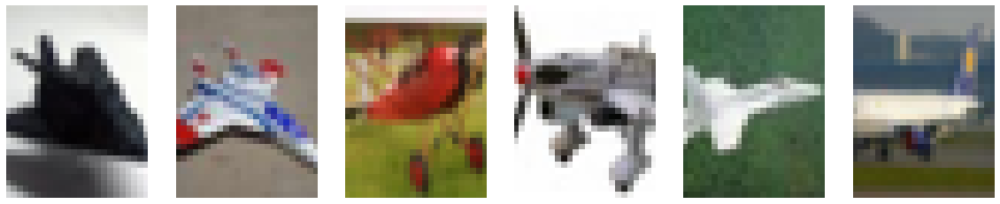

In [2]:
# Setting the keras backend data format to "channel_last", because the cifar10.load_data() return this format.
K.set_image_data_format('channels_last')
# Loading the data from cifar10 (10 class 5000 train 1000 test, 60000 images)
## 0 Airplane
## 1 Car
## 2 Bird
## 3 Cat
## 4 Deer
## 5 Dog
## 6 Frog
## 7 Horse
## 8 Ship
## 9 Truck
(x_train, y_train), (x_test, y_test) = cifar10.load_data()
# I have choosen the airplane (0) class
# Getting the position of the images which contains airplane (test, and train)
airplane_train_index = np.transpose(np.where(y_train == 0)[0])
airplane_test_index  = np.transpose(np.where(y_test  == 0)[0])
# New x_train, x_test dataset with the choosen class pictures 
x_train_choosen = np.delete(x_train.copy(), np.delete(np.array(range(len(x_train))), airplane_train_index), axis = 0);
x_test_choosen  = np.delete(x_test.copy(),  np.delete(np.array(range(len(x_test))),  airplane_test_index),  axis = 0);
# Fuse the training set and the testing set (6000 picture) and normalizing them 
x_train_choosen = np.concatenate((x_train_choosen, x_test_choosen), axis = 0)/255

# Check some images
fig, axes = plt.subplots(figsize=(20, 4), nrows=1, ncols=6, sharey=True, sharex=False)
for i in range(6):
    axes[i].xaxis.set_visible(False)
    axes[i].yaxis.set_visible(False)
    im = axes[i].imshow(x_train[i])


In [0]:
## Github source: https://github.com/halahup/Machine-Learning/tree/master/DCGAN/Cifar10
## Copied from the README.md
class DCGAN:
    """
        A 4-layer generator - 4-layer discriminator Deep Convolutional Generative Adversarial Network
        
        Huperparameters and optimizers are defaulted to those describe in the paper: 
        
            UNSUPERVISED REPRESENTATION LEARNING WITH DEEP CONVOLUTIONAL
            GENERATIVE ADVERSARIAL NETWORKS
            
            by 
            
            Alec Radford & Luke Metz
            indico Research
            Boston, MA {alec,luke}@indico.io
            
            Soumith Chintala
            Facebook AI Research New York, NY soumith@fb.com
    """
    
    def __init__(self, x_train, gen_dims=100):
        """
            Initializes the Deep Convolutional Gan
            
            Ags:
                x_train (np.array): the set we want to sample generated images from
                gen_dims (int): dimension of the noise for the generated images
        """
        
        self.training_set = x_train
        self.samples = []  # empty array to hold the samples
        self.losses = []  # empty array to hold the losses
        self.gen_dims = gen_dims
        self.weights = []
    
    def __generator(self, input_layer, kernel_size=5, reuse=False, lrelu_slope=0.2, kernel_initializer=tf.contrib.layers.xavier_initializer(), training=True):
        """
            Builds the generator CNN
            
            Args:
                input_layer (Tensor): The input layer to the network - gaussian noise placeholder
                kernel_initializer: weight initializer for the CNN layers
                kernel_size (int): size of the perceptive field
                reuse (bool): reuse parameter to reuse the variables
                lrelu_slope (np.float16): slope for the leaky relu activation function
                training (bool): batch normalization training
                
            Returns:
                out (Tensor): generated image
        """
        
        # use the xavier initializer for the weights
        w_init = kernel_initializer
        
        # use the variable scope to fetch the vars later
        with tf.variable_scope('generator', reuse=reuse):

            # reshape the noise into a volume
            input_dense = tf.layers.dense(inputs=input_layer, units=2*2*256)
            input_volume = tf.reshape(tensor=input_dense, shape=(-1, 2, 2, 256))
            h1 = tf.layers.batch_normalization(inputs=input_volume, training=training)  # batch norm
            h1 = tf.maximum(h1 * lrelu_slope, h1) # leaky relu
            # 2x2x256

            # deconv - upsample
            h2 = tf.layers.conv2d_transpose(filters=128, strides=2, kernel_size=kernel_size, padding='same', inputs=h1, activation=None, kernel_initializer=w_init)
            h2 = tf.layers.batch_normalization(inputs=h2, training=training)
            h2 = tf.maximum(h2 * lrelu_slope, h2) # leaky relu
            # 4x4x128

            # deconv - upsample
            h3 = tf.layers.conv2d_transpose(filters=64, strides=2, kernel_size=kernel_size, padding='same', inputs=h2, activation=None, kernel_initializer=w_init)
            h3 = tf.layers.batch_normalization(inputs=h3, training=training)
            h3 = tf.maximum(h3 * lrelu_slope, h3)
            # 8x8x64

            # deconv - upsample
            h4 = tf.layers.conv2d_transpose(filters=32, strides=2, kernel_size=kernel_size, padding='same', inputs=h3, activation=None, kernel_initializer=w_init)
            h4 = tf.layers.batch_normalization(inputs=h4, training=training)
            h4 = tf.maximum(h4 * lrelu_slope, h4)
            # 16x16x32

            # deconv - upsample
            logits = tf.layers.conv2d_transpose(filters=3, strides=2, kernel_size=kernel_size, padding='same', inputs=h4, activation=None, kernel_initializer=w_init)
            # 32x32x3

            # output image
            out = tf.tanh(x=logits)

            return out
    
    def __discriminator(self, input_layer, reuse=False, lrelu_slope=0.2, kernel_initializer=tf.contrib.layers.xavier_initializer(), kernel_size=5):
        """
            Builds the discriminator CNN
            
            Args:
                input_layer (Tensor): The input layer to the network - image from the training set
                kernel_initializer: weight initializer for the CNN layers
                kernel_size (int): size of the perceptive field
                reuse (bool): reuse parameter to reuse the variables
                lrelu_slope (np.float16): slope for the leaky relu activation function
                
            Returns:
                out (Tensor): probability that the image is generated
                logits (Tensor): logits of the discriminator
        """
        
        # use the xavier initializer for the weights
        w_init = kernel_initializer
        
        with tf.variable_scope('discriminator', reuse=reuse):
        
            # conv - 32x32x3 -> 16x16x364 -- we don't use the batch norm on the first layer of discriminator
            h1 = tf.layers.conv2d(inputs=input_layer, filters=32, strides=2, kernel_size=kernel_size, padding='same', kernel_initializer=w_init)
            h1 = tf.maximum(h1 * lrelu_slope, h1)

            # conv - 16x16x64 -> 8x8x128
            h2 = tf.layers.conv2d(inputs=h1, filters=64, strides=2, kernel_size=kernel_size, padding='same', kernel_initializer=w_init)
            h2 = tf.layers.batch_normalization(inputs=h2, training=True)
            h2 = tf.maximum(h2 * lrelu_slope, h2)

            # conv - 8x8x128 -> 4x4x256
            h3 = tf.layers.conv2d(inputs=h2, filters=128, strides=2, kernel_size=kernel_size, padding='same', kernel_initializer=w_init)
            h3 = tf.layers.batch_normalization(inputs=h3, training=True)
            h3 = tf.maximum(h3 * lrelu_slope, h3)

            # conv - 4x4x256 -> 2x2x512
            h4 = tf.layers.conv2d(inputs=h3, filters=256, strides=2, kernel_size=kernel_size, padding='same', kernel_initializer=w_init)
            h4 = tf.layers.batch_normalization(inputs=h4, training=True)
            h4 = tf.maximum(h4 * lrelu_slope, h4)

            # flatten the array
            flatten = tf.reshape(tensor=h4, shape=(-1, 2*2*256))

            # logits
            logits = tf.layers.dense(inputs=flatten, units=1, activation=None, kernel_initializer=w_init)

            # output
            out = tf.sigmoid(x=logits)

            return out, logits
    
    def __inputs(self):
        """
            Creates the imput tensors for the generator and the discriminator
            
            Returns:
                gen_input (Tensor): input placeholder for the generator
                real_input (Tensor): input placeholder for the discriminator
        """
        
        # define the input placeholders
        gen_input = tf.placeholder(shape=(None, self.gen_dims), dtype=tf.float32)
        real_input = tf.placeholder(shape=(None, 32, 32, 3), dtype=tf.float32)
        
        return gen_input, real_input
    
    def __setup_losses_and_optimizers(self, lr=0.0005, beta1=0.5, beta2=0.999):
        """
            Builds the computational graph for the network
            
            Args:
                lr (float): learning rate for the optimizer
                beta1 (float): beta1 parameter for the ADAM optimizer
                beta2 (float): beta2 parameter for ADAM
            
            Returns:
                discriminator_optimizer: optimizer op for the discriminator 
                generator_optimizer: optimizer op for the generator
                disc_loss: discriminator loss
                gen_loss: generator loss
                gen_input: pass through generator input - noise
                real_input: pass through real image input
        """
        
        # - - - BUILD THE GRAPH - - -      
        # reset the default graph
        tf.reset_default_graph()

        # define the input placeholders
        gen_input, real_input = self.__inputs()
        
        # build the generator
        gen_images = self.__generator(input_layer=gen_input, 
                                      kernel_size=5, 
                                      reuse=False, 
                                      lrelu_slope=0.2, 
                                      kernel_initializer=tf.contrib.layers.xavier_initializer(), 
                                      training=True)

        # build the discriminator for the real images
        disc_output_real_image, disc_logits_real_image = self.__discriminator(input_layer=real_input, 
                                                                              reuse=False, 
                                                                              lrelu_slope=0.2,
                                                                              kernel_initializer=tf.contrib.layers.xavier_initializer(), 
                                                                              kernel_size=5)
        
        # build the discriminator for fake images
        # reuse the variables that we have from the real images
        disc_output_gen_image, disc_logits_gen_image = self.__discriminator(input_layer=gen_images, 
                                                                            reuse=True, 
                                                                            lrelu_slope=0.2, 
                                                                            kernel_initializer=tf.contrib.layers.xavier_initializer(), 
                                                                            kernel_size=5)

        # - - - LOSSES - - -
        # generator loss
        gen_loss = tf.reduce_mean(tf.losses.sigmoid_cross_entropy(logits=disc_logits_gen_image, multi_class_labels=tf.ones_like(disc_logits_gen_image)))
        
        # discriminator loss
        disc_loss_real_images = tf.reduce_mean(tf.losses.sigmoid_cross_entropy(logits=disc_logits_real_image, multi_class_labels=tf.ones_like(disc_logits_real_image)))
        disc_loss_gen_images = tf.reduce_mean(tf.losses.sigmoid_cross_entropy(logits=disc_logits_gen_image, multi_class_labels=tf.zeros_like(disc_logits_gen_image)))
        disc_loss = disc_loss_real_images + disc_loss_gen_images

        # get the variables for the generator and discriminator
        generator_variables = [var for var in tf.trainable_variables() if var.name.startswith('generator')]
        discriminator_variables = [var for var in tf.trainable_variables() if var.name.startswith('discriminator')]

        # setup the optimizers
        # comtrol for the global sample mean and variance
        with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
            generator_optimizer = tf.train.AdamOptimizer(learning_rate=lr, beta1=beta1, beta2=beta2).minimize(gen_loss, var_list=generator_variables)
            discriminator_optimizer = tf.train.AdamOptimizer(learning_rate=lr, beta1=beta1, beta2=beta2).minimize(disc_loss, var_list=discriminator_variables)
        
        return discriminator_optimizer, generator_optimizer, disc_loss, gen_loss, gen_input, real_input
    
    def train(self, batch_size=128, epochs=100):
        """
            Trains the DCGAN
            
            Args:
                batch_size (int): size of a batch
                epochs (int): number of epochs to train for
        """
        
        d_opt, g_opt, d_loss, g_loss, gen_input, real_input = self.__setup_losses_and_optimizers()
        
        # - - - TRAIN - - -
        # run the session
        with tf.Session() as sess:

            # initialize the variables
            sess.run(tf.global_variables_initializer())

            # train the network
            for epoch in tqdm(range(epochs)):

                for step, batch in enumerate(self.__next_batch(self.training_set, batch_size)):
                    
                    # generate the noise
                    noise = np.random.uniform(low=-1, high=1, size=(batch_size, self.gen_dims))

                    # feed the noise through the generator
                    _ = sess.run(g_opt, feed_dict={gen_input: noise, real_input: batch})

                    # feed the channel and the noise to the discriminator
                    _ = sess.run(d_opt, feed_dict={gen_input: noise, real_input: batch})

                    # get the generator and discriminator losses
                    gen_loss, disc_loss = sess.run([g_loss, d_loss], feed_dict={gen_input: noise, real_input: batch})
                    
                    # append all the losses on every iteration
                    self.losses.append((gen_loss, disc_loss))
                
                # every second epoch
                if epoch % 2 == 0:
                    # sample more noise
                    sample_noise = np.random.uniform(low=-1, high=1, size=(72, self.gen_dims))

                    # generate images
                    gen_samples = sess.run(self.__generator(gen_input, reuse=True, training=False), feed_dict={gen_input: sample_noise})
                    
                    # append the images to the samples
                    self.samples.append(gen_samples)
                    
                    # view samples from the last epoch
                    _ = self.view_samples(-1, self.samples, 6, 12, figsize=(10,5))
                    plt.show()
                
    def __next_batch(self, data, batch_size=128):
        """
            Generates the batches of data
        
            Args:
                batch_size (int): size of the batch
        
            Returns:
                batch based on the batch_size
        """
        
        # get the number of partitions
        number_of_partitions = data.shape[0]//batch_size

        # shuffle the examples
        np.random.shuffle(self.training_set)

        # partition the examples
        for batch in np.array_split(self.training_set[:number_of_partitions*batch_size], number_of_partitions):
            yield batch * 2 - 1  # scale to -1 to 1
    
    def view_samples(self, epoch, samples, nrows, ncols, figsize=(5, 5)):
        """
            Shows generated samples
            The function is taken from Udacity's DL nanodegree course
            
            Args:
                epoch (int): the epochs to fetch the samples from 
                nrows (int): number of rows in the grid
                ncols (int): number of columns in the grid
                figsize (int, int): figure size
                
            Returns:
                fig (matplotlib.figure.Figure): figure object
                axes (matplotlib.axes._subplots.AxesSubplot): ax objects
        """
        
        # ge the figure and the axes
        fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, sharey=True, sharex=True)

        # draw the samples
        for ax, img in zip(axes.flatten(), samples[epoch]):
            ax.axis('off')
            img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
            ax.set_adjustable('box-forced')
            im = ax.imshow(img, aspect='equal')
        plt.subplots_adjust(wspace=0, hspace=0)
        return fig, axes

In [0]:
# Instantiating the DCGAN class with our training pictures
gan = DCGAN(x_train)


  0%|          | 0/30 [00:00<?, ?it/s]

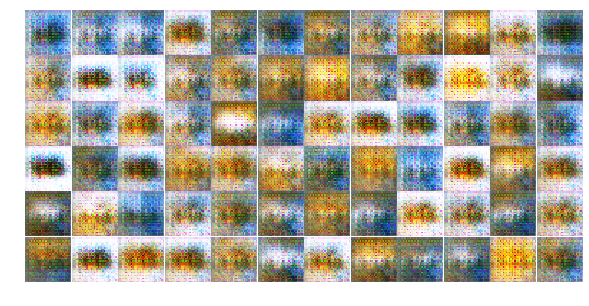


  7%|▋         | 2/30 [00:24<06:15, 13.42s/it]

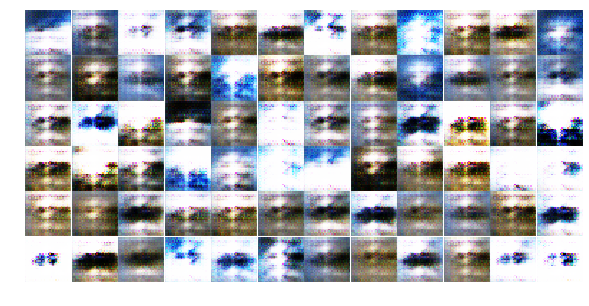


 13%|█▎        | 4/30 [00:47<05:19, 12.31s/it]

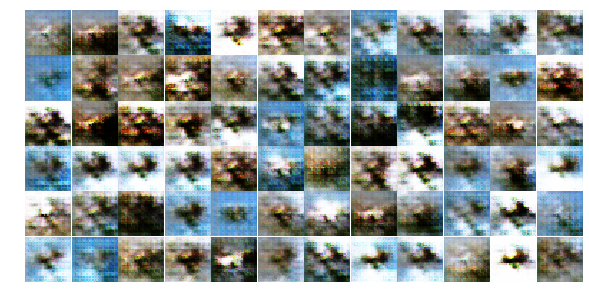


 20%|██        | 6/30 [01:11<04:43, 11.83s/it]

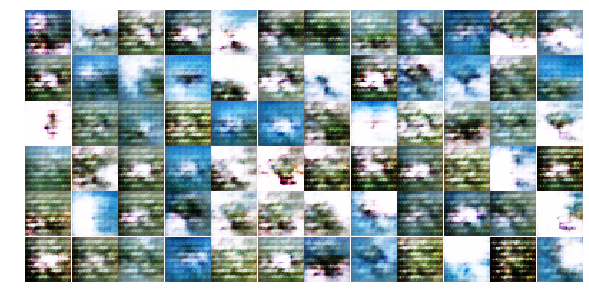


 27%|██▋       | 8/30 [01:34<04:13, 11.53s/it]

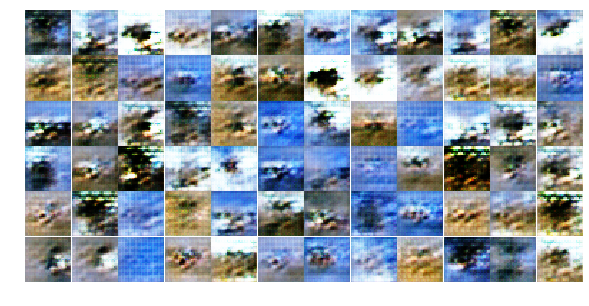


 33%|███▎      | 10/30 [01:58<03:47, 11.40s/it]

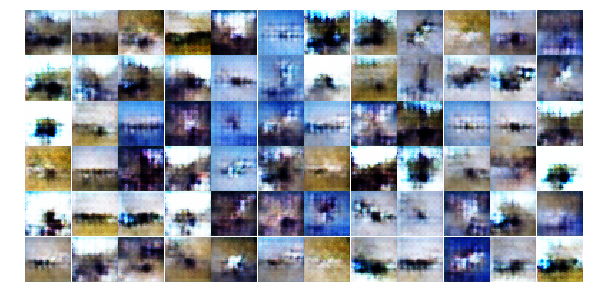


 40%|████      | 12/30 [02:21<03:23, 11.32s/it]

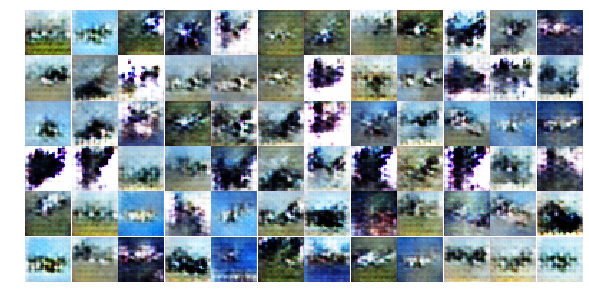


 47%|████▋     | 14/30 [02:44<03:00, 11.27s/it]

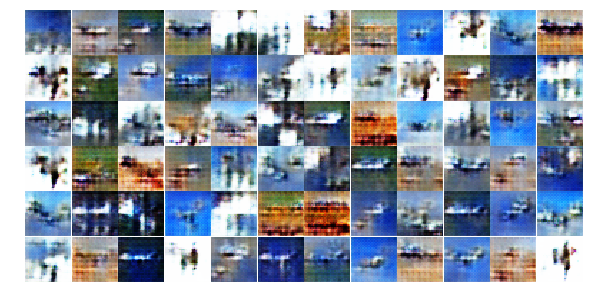


 53%|█████▎    | 16/30 [03:08<02:37, 11.24s/it]

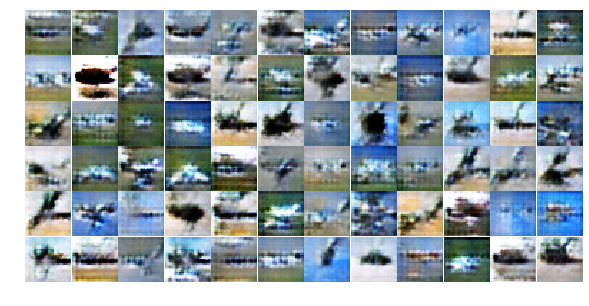


 60%|██████    | 18/30 [03:31<02:15, 11.25s/it]

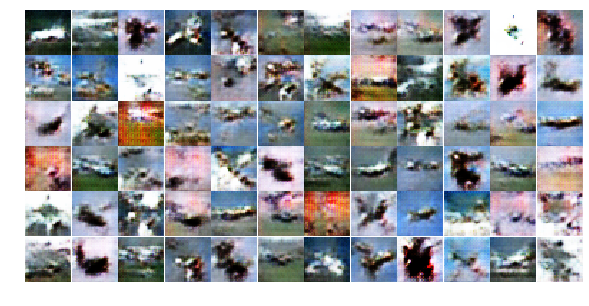


 67%|██████▋   | 20/30 [03:54<01:52, 11.24s/it]

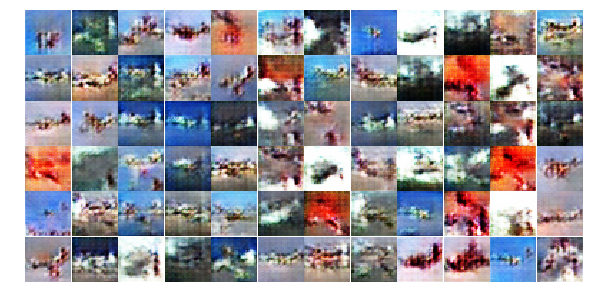


 73%|███████▎  | 22/30 [04:18<01:30, 11.27s/it]

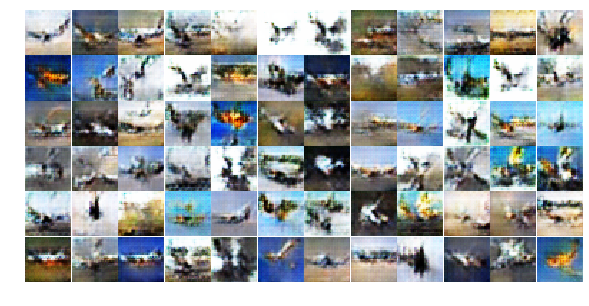


 80%|████████  | 24/30 [04:41<01:07, 11.29s/it]

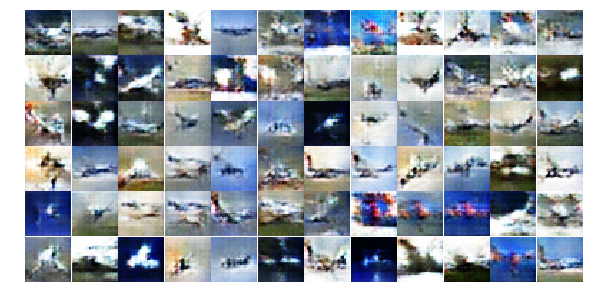


 87%|████████▋ | 26/30 [05:05<00:45, 11.29s/it]

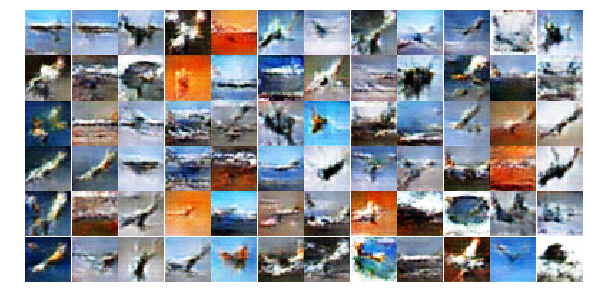


 93%|█████████▎| 28/30 [05:28<00:22, 11.21s/it]

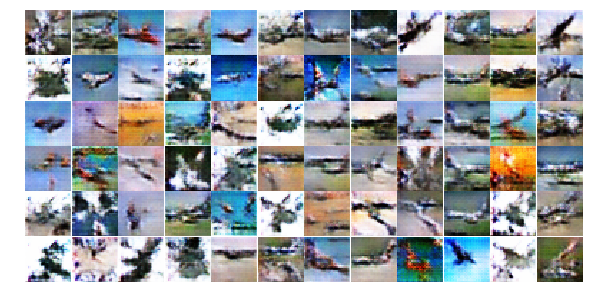


100%|██████████| 30/30 [05:52<00:00, 11.38s/it]


In [0]:
# Training the GAN network through 30 epochs with batch_size 32
gan.train(batch_size=32, epochs=30)


  0%|          | 0/300 [00:00<?, ?it/s]

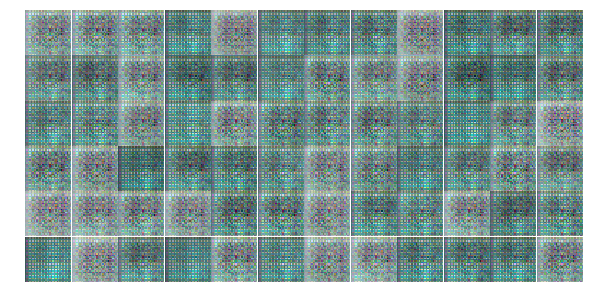


  1%|          | 2/300 [00:19<54:47, 11.03s/it]  

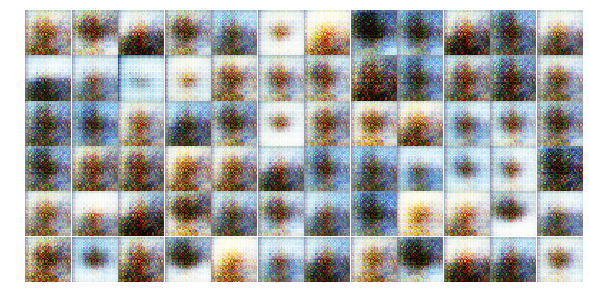


  1%|▏         | 4/300 [00:38<49:32, 10.04s/it]

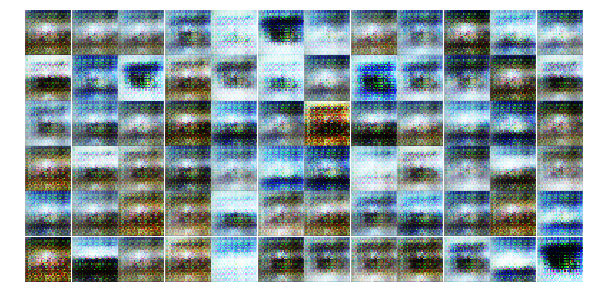


  2%|▏         | 6/300 [00:57<46:56,  9.58s/it]

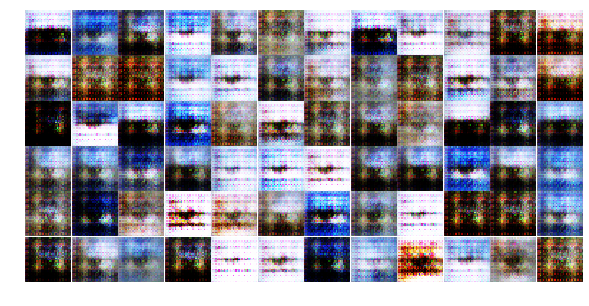


  3%|▎         | 8/300 [01:17<45:28,  9.34s/it]

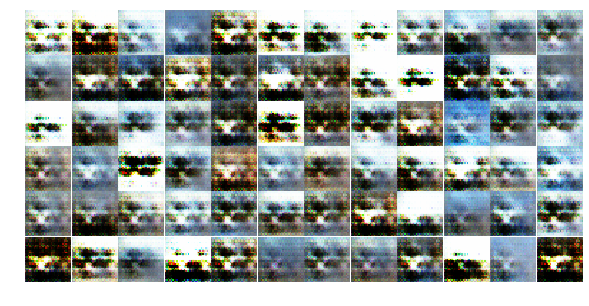


  3%|▎         | 10/300 [01:36<44:43,  9.25s/it]

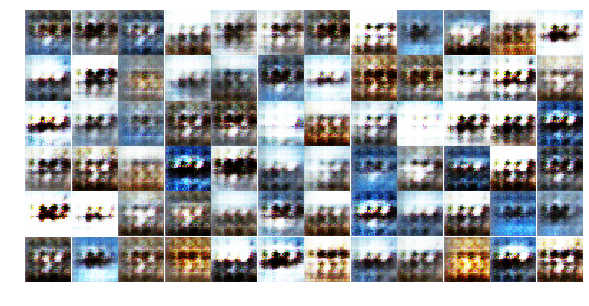


  4%|▍         | 12/300 [01:55<44:10,  9.20s/it]

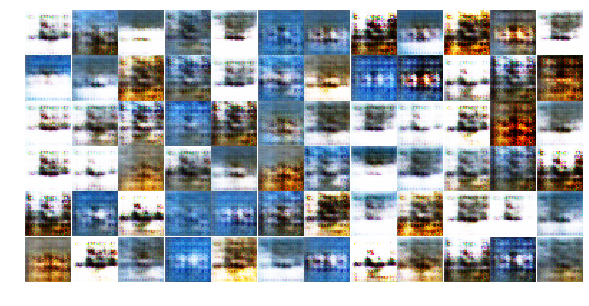


  5%|▍         | 14/300 [02:14<43:40,  9.16s/it]

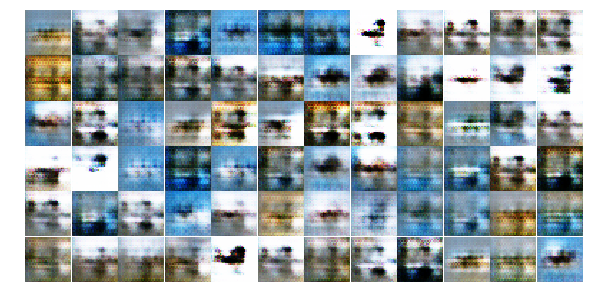


  5%|▌         | 16/300 [02:33<43:17,  9.15s/it]

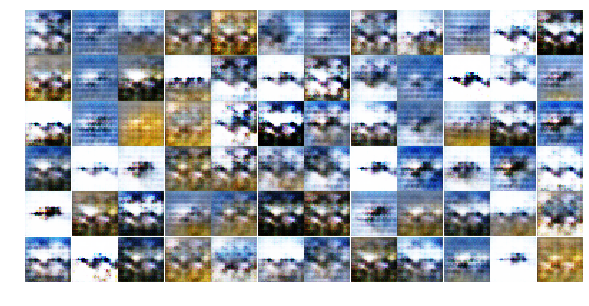


  6%|▌         | 18/300 [02:52<43:08,  9.18s/it]

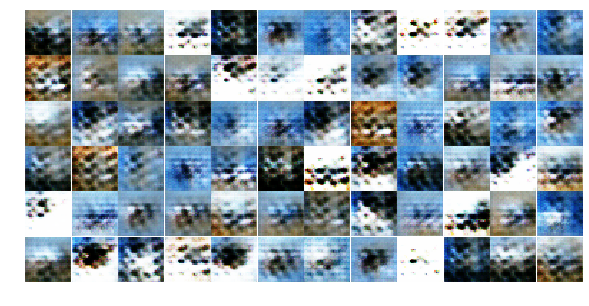


  7%|▋         | 20/300 [03:11<42:46,  9.17s/it]

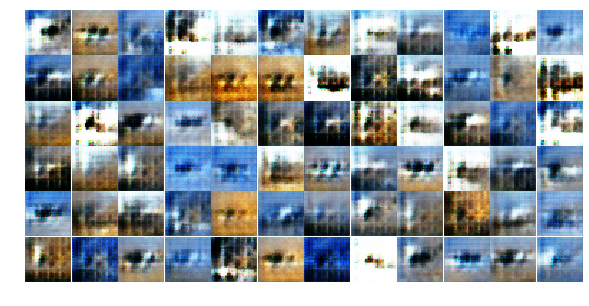


  7%|▋         | 22/300 [03:31<42:40,  9.21s/it]

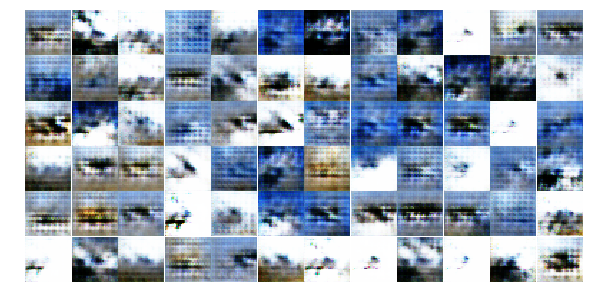


  8%|▊         | 24/300 [03:50<42:22,  9.21s/it]

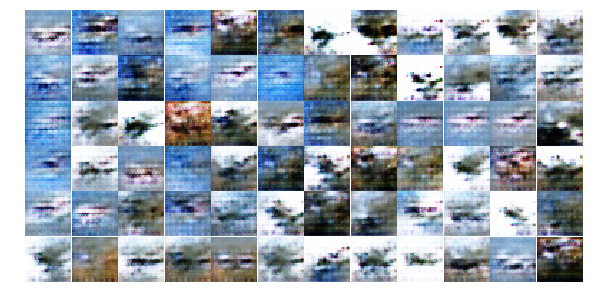


  9%|▊         | 26/300 [04:09<41:56,  9.18s/it]

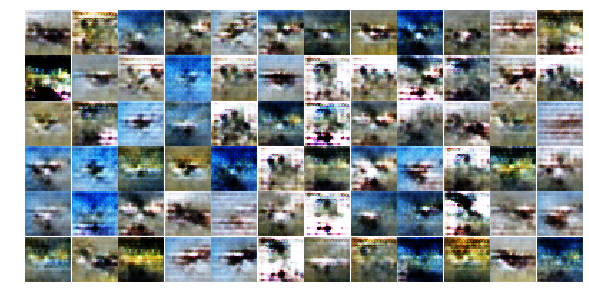


  9%|▉         | 28/300 [04:29<41:35,  9.18s/it]

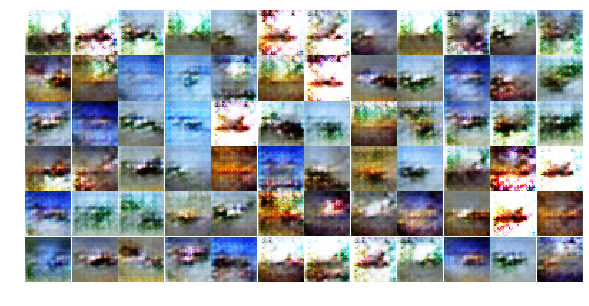


 10%|█         | 30/300 [04:48<41:21,  9.19s/it]

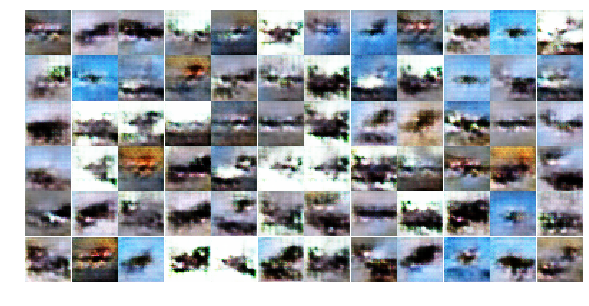


 11%|█         | 32/300 [05:07<41:02,  9.19s/it]

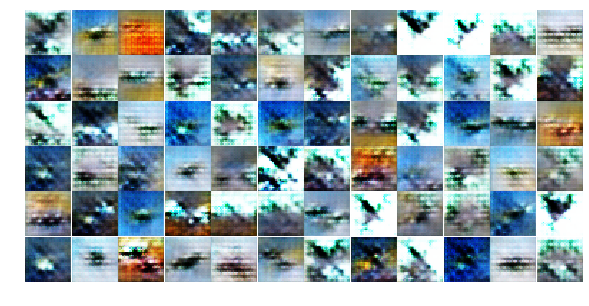


 11%|█▏        | 34/300 [05:26<40:49,  9.21s/it]

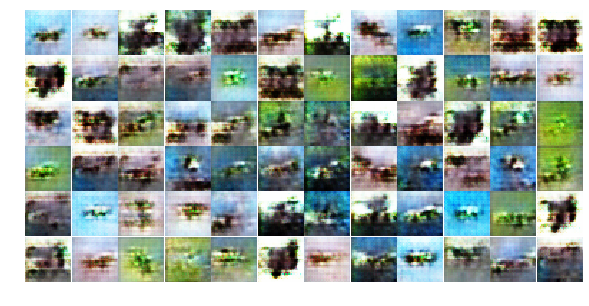


 12%|█▏        | 36/300 [05:45<40:21,  9.17s/it]

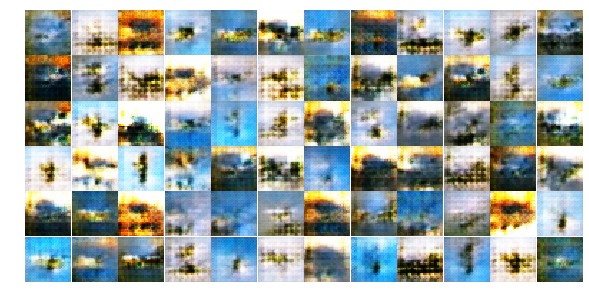


 13%|█▎        | 38/300 [06:05<40:11,  9.20s/it]

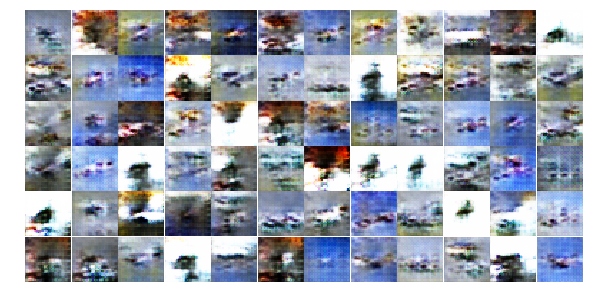


 13%|█▎        | 40/300 [06:24<40:03,  9.25s/it]

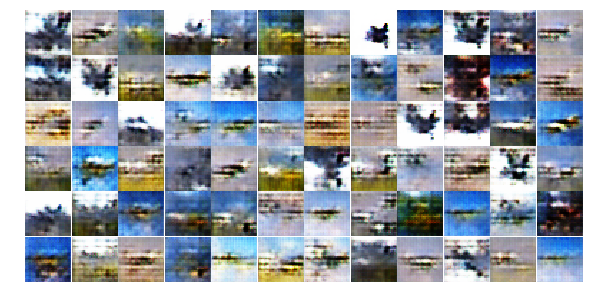


 14%|█▍        | 42/300 [06:43<39:37,  9.21s/it]

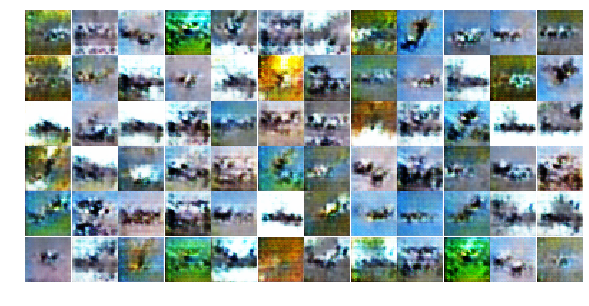


 15%|█▍        | 44/300 [07:02<39:01,  9.15s/it]

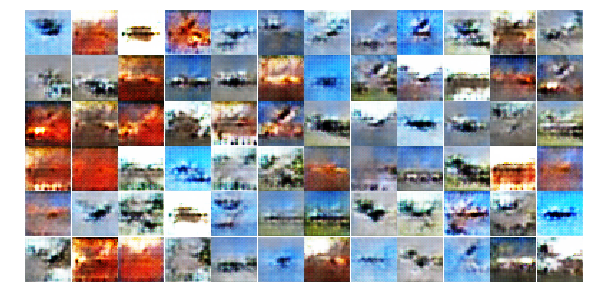


 15%|█▌        | 46/300 [07:22<38:58,  9.21s/it]

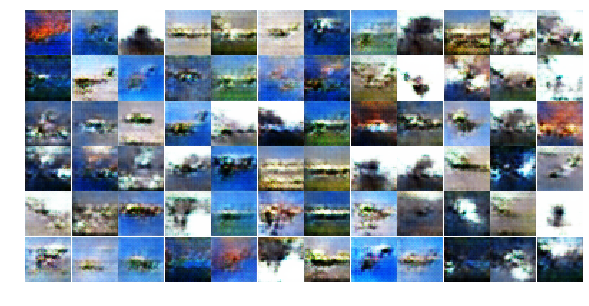


 16%|█▌        | 48/300 [07:41<38:36,  9.19s/it]

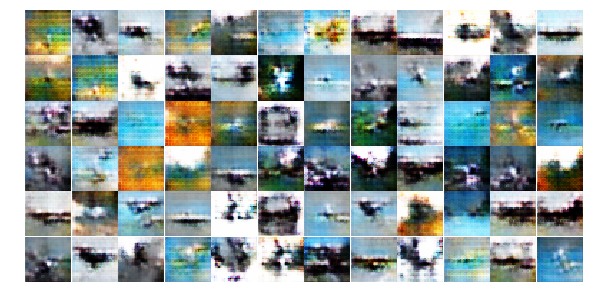


 17%|█▋        | 50/300 [08:01<38:33,  9.26s/it]

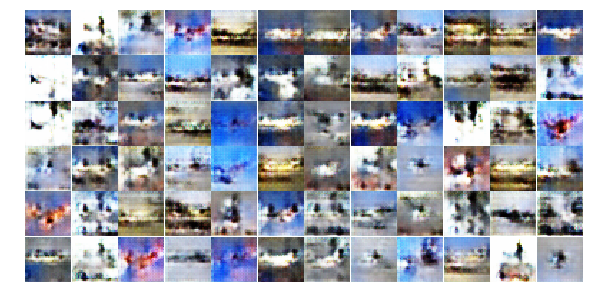


 17%|█▋        | 52/300 [08:20<37:51,  9.16s/it]

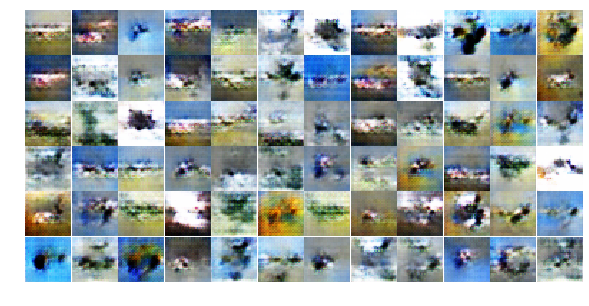


 18%|█▊        | 54/300 [08:39<37:46,  9.21s/it]

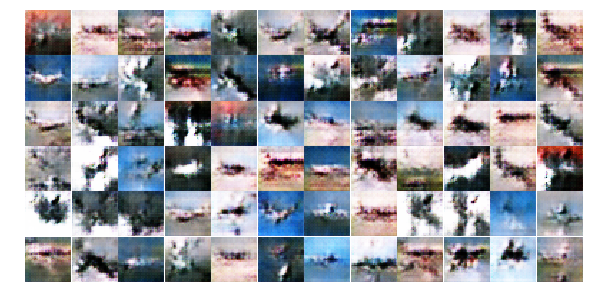


 19%|█▊        | 56/300 [08:58<37:26,  9.21s/it]

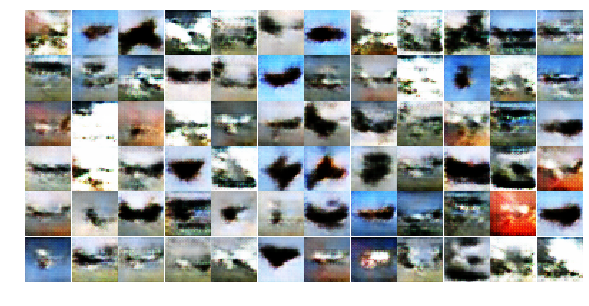


 19%|█▉        | 58/300 [09:18<37:04,  9.19s/it]

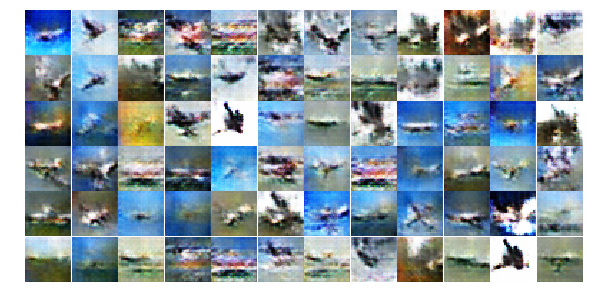


 20%|██        | 60/300 [09:37<36:58,  9.24s/it]

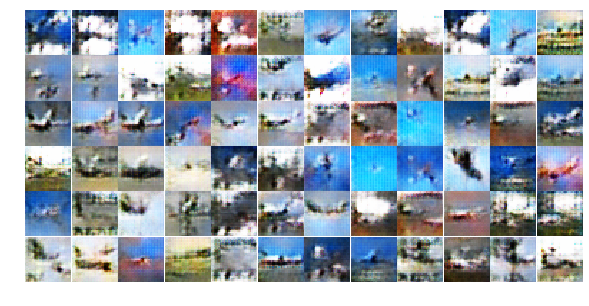


 21%|██        | 62/300 [09:56<36:39,  9.24s/it]

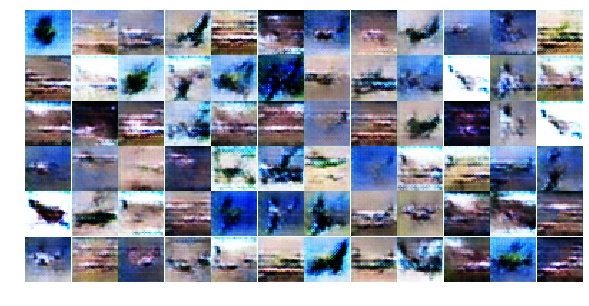


 21%|██▏       | 64/300 [10:16<36:19,  9.23s/it]

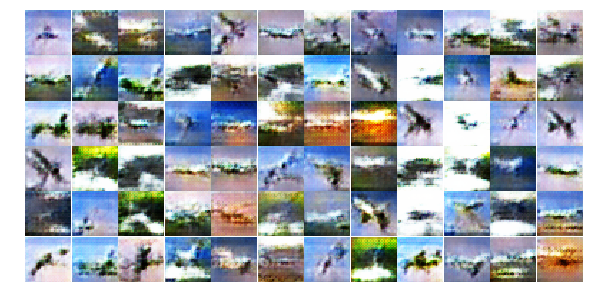


 22%|██▏       | 66/300 [10:35<36:06,  9.26s/it]

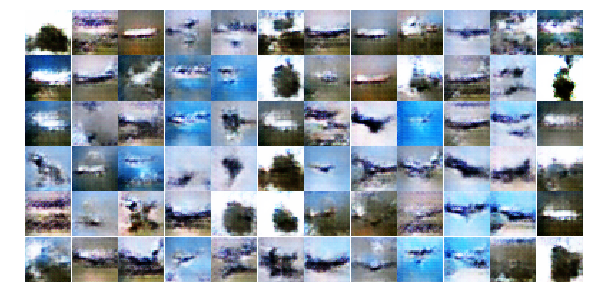


 23%|██▎       | 68/300 [10:55<35:47,  9.25s/it]

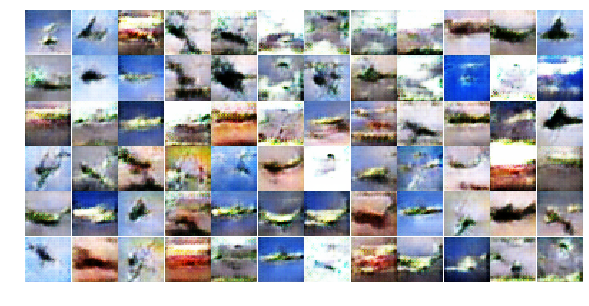


 23%|██▎       | 70/300 [11:14<35:24,  9.24s/it]

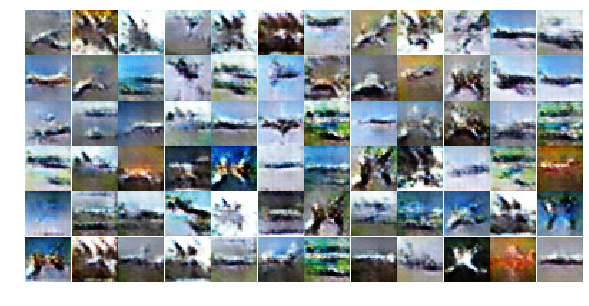


 24%|██▍       | 72/300 [11:33<35:16,  9.28s/it]

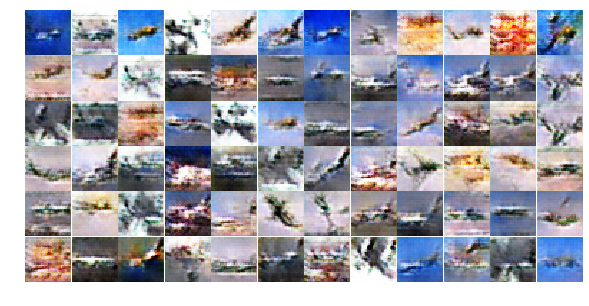


 25%|██▍       | 74/300 [11:53<35:14,  9.36s/it]

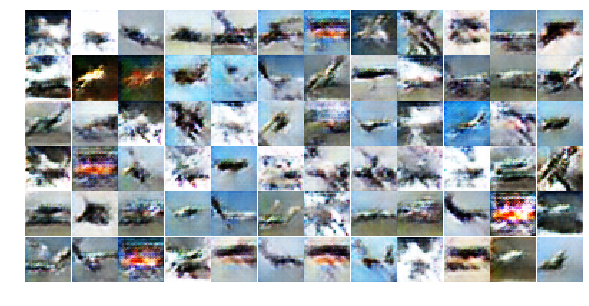


 25%|██▌       | 76/300 [12:13<34:45,  9.31s/it]

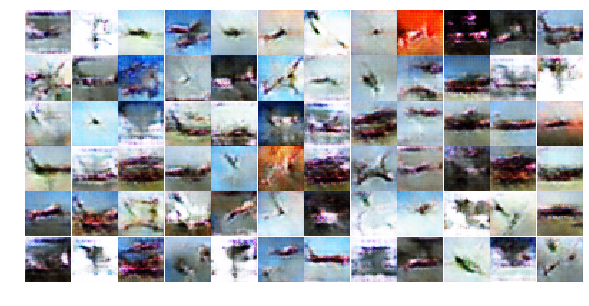


 26%|██▌       | 78/300 [12:32<34:46,  9.40s/it]

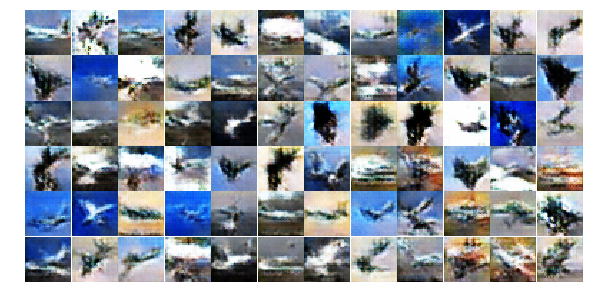


 27%|██▋       | 80/300 [12:52<34:44,  9.47s/it]

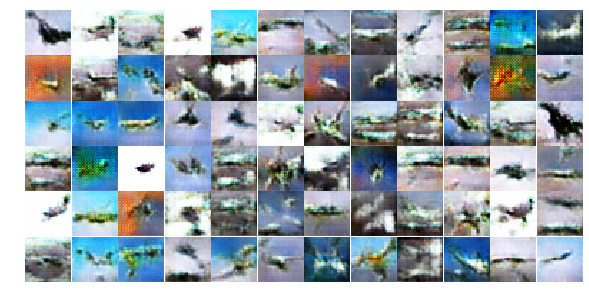


 27%|██▋       | 82/300 [13:12<34:33,  9.51s/it]

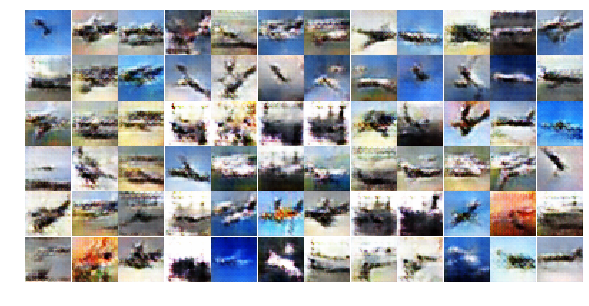


 28%|██▊       | 84/300 [13:32<34:27,  9.57s/it]

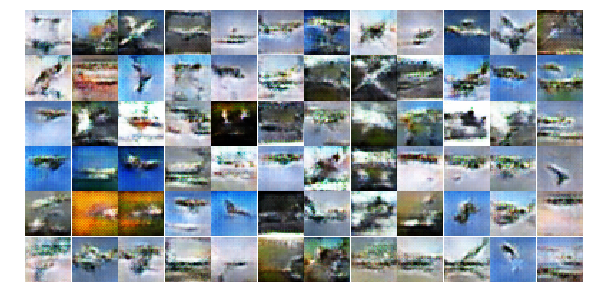


 29%|██▊       | 86/300 [13:52<33:48,  9.48s/it]

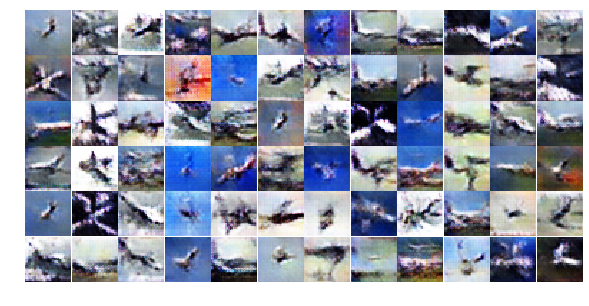


 29%|██▉       | 88/300 [14:12<33:25,  9.46s/it]

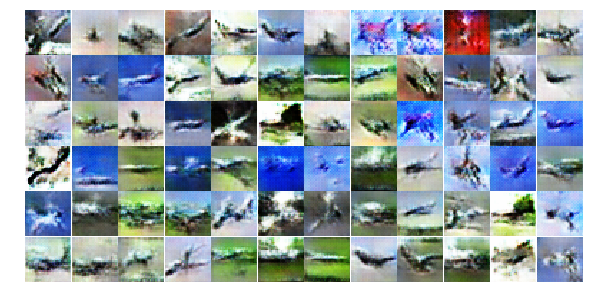


 30%|███       | 90/300 [14:31<32:53,  9.40s/it]

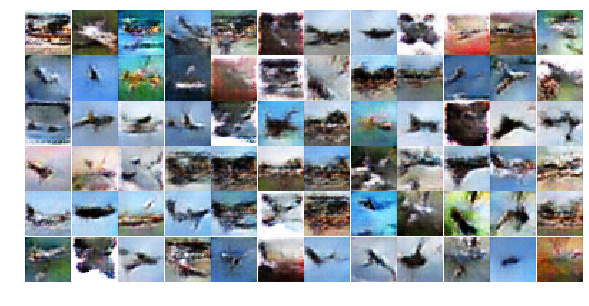


 31%|███       | 92/300 [14:51<32:34,  9.40s/it]

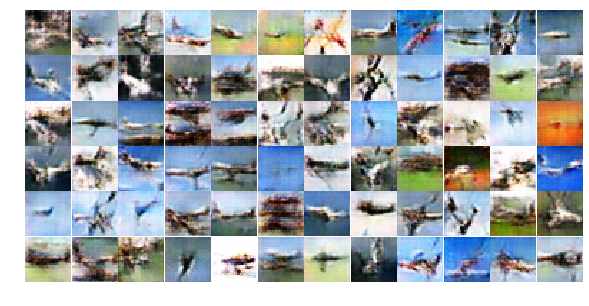


 31%|███▏      | 94/300 [15:11<32:16,  9.40s/it]

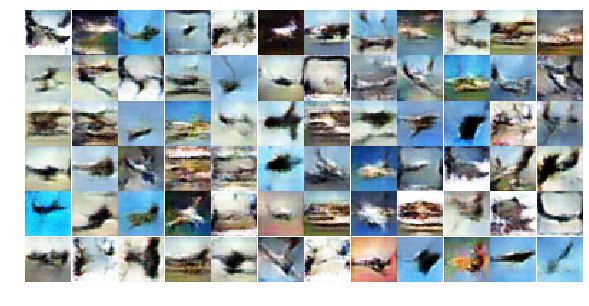


 32%|███▏      | 96/300 [15:31<32:12,  9.47s/it]

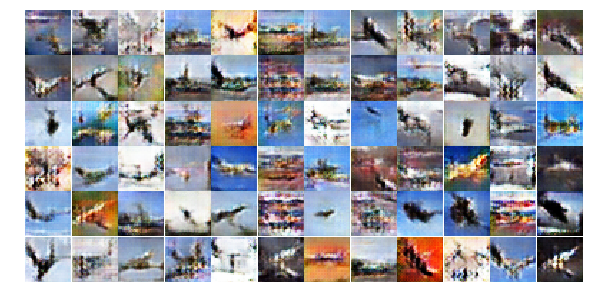


 33%|███▎      | 98/300 [15:51<31:47,  9.44s/it]

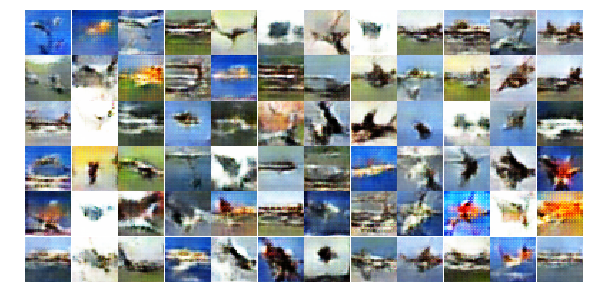


 33%|███▎      | 100/300 [16:10<31:32,  9.46s/it]

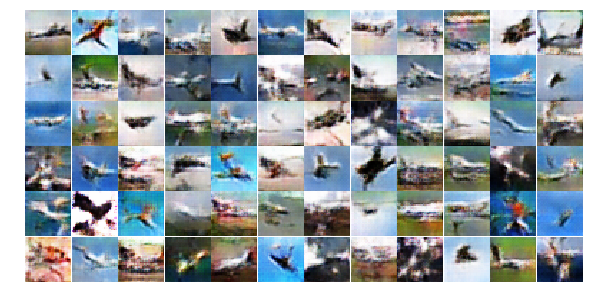


 34%|███▍      | 102/300 [16:30<31:04,  9.42s/it]

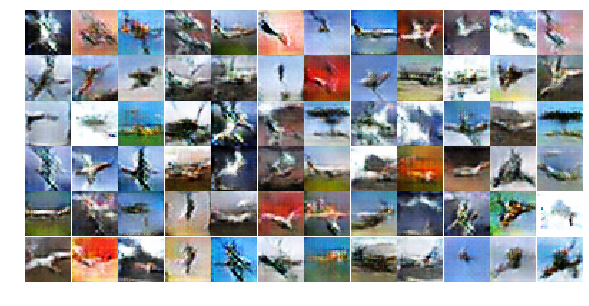


 35%|███▍      | 104/300 [16:50<30:58,  9.48s/it]

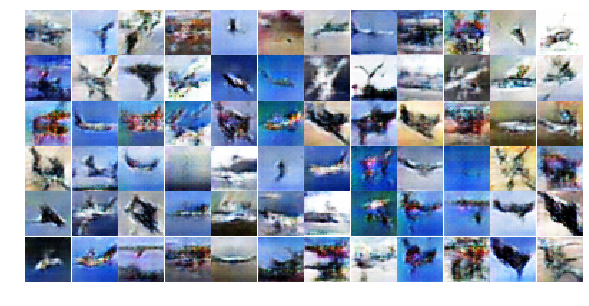


 35%|███▌      | 106/300 [17:10<30:41,  9.49s/it]

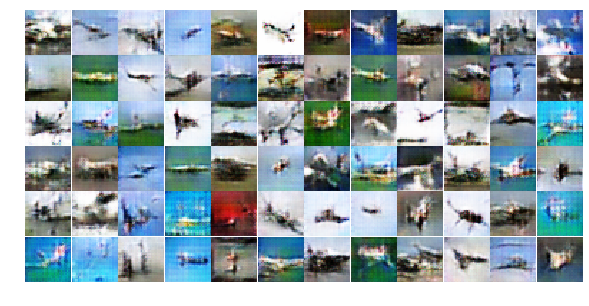


 36%|███▌      | 108/300 [17:30<30:47,  9.62s/it]

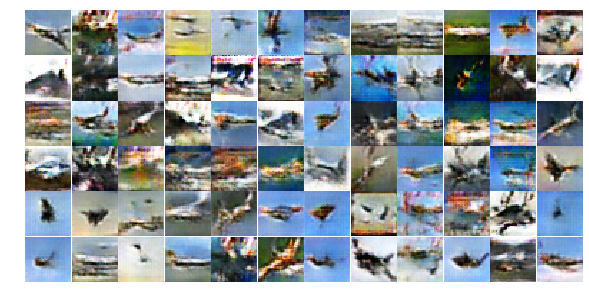


 37%|███▋      | 110/300 [17:51<30:30,  9.63s/it]

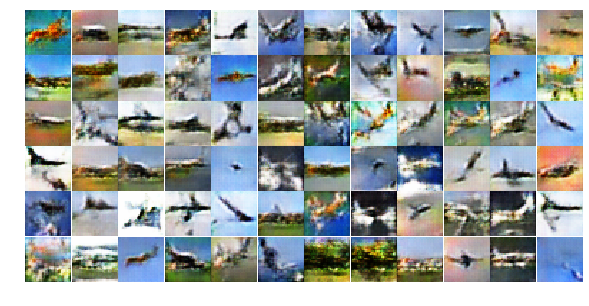


 37%|███▋      | 112/300 [18:10<29:57,  9.56s/it]

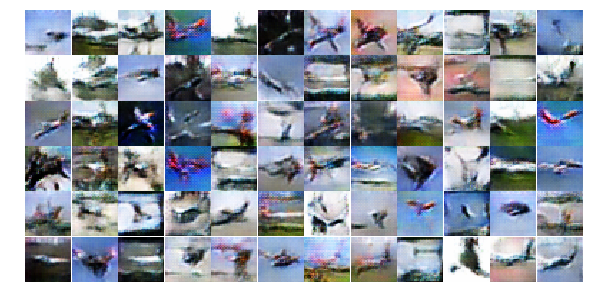


 38%|███▊      | 114/300 [18:31<30:00,  9.68s/it]

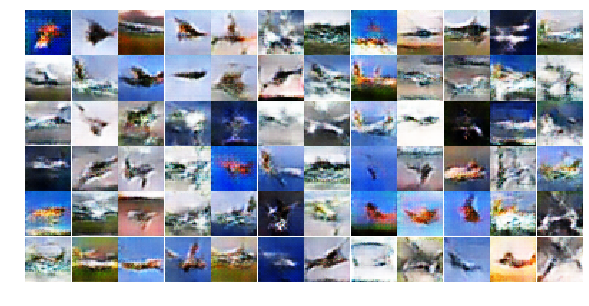


 39%|███▊      | 116/300 [18:51<29:26,  9.60s/it]

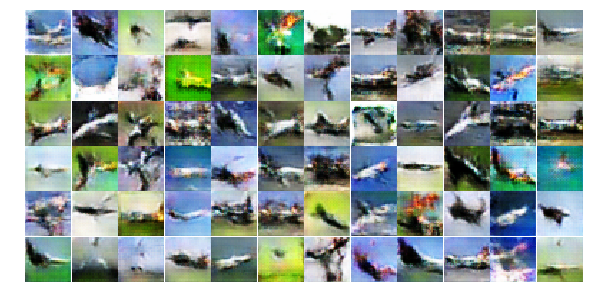


 39%|███▉      | 118/300 [19:11<28:44,  9.48s/it]

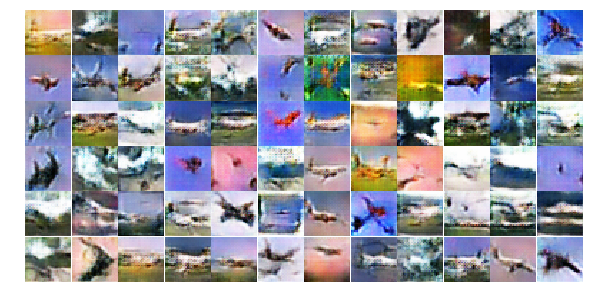


 40%|████      | 120/300 [19:30<28:07,  9.38s/it]

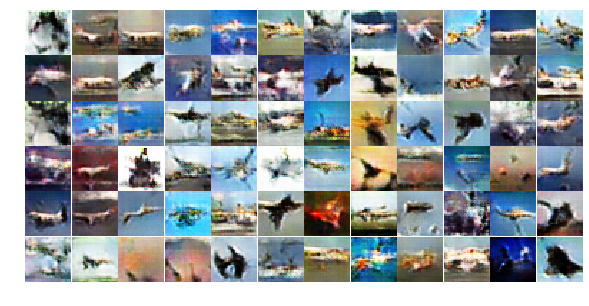


 41%|████      | 122/300 [19:50<28:10,  9.50s/it]

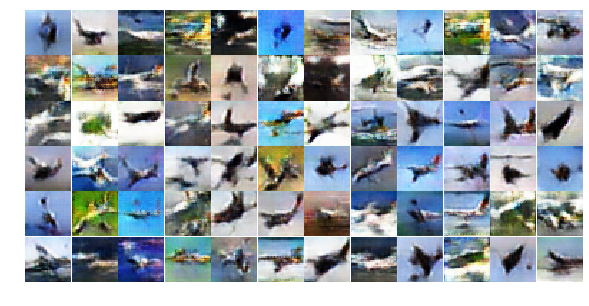


 41%|████▏     | 124/300 [20:10<28:07,  9.59s/it]

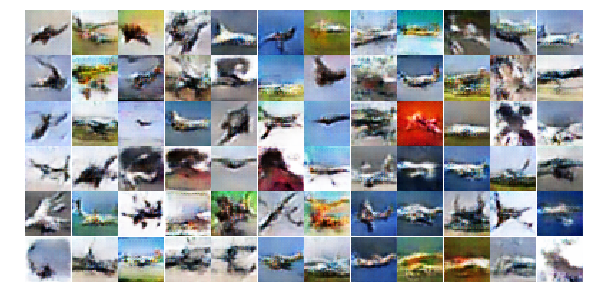


 42%|████▏     | 126/300 [20:30<27:42,  9.56s/it]

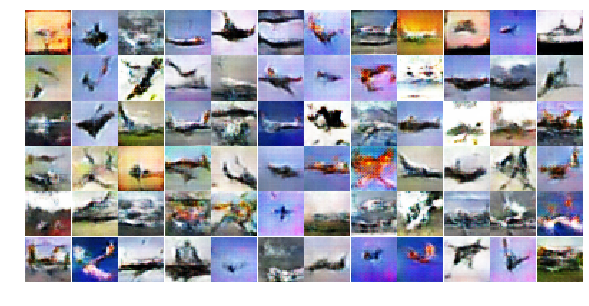


 43%|████▎     | 128/300 [20:51<27:43,  9.67s/it]

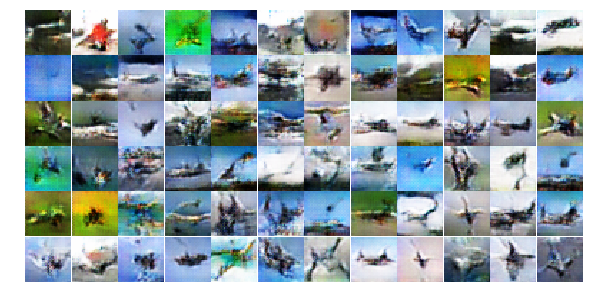


 43%|████▎     | 130/300 [21:11<27:30,  9.71s/it]

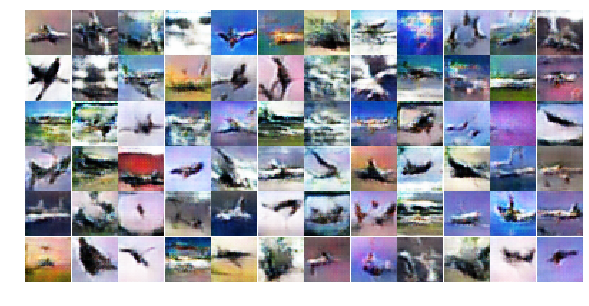


 44%|████▍     | 132/300 [21:31<26:58,  9.64s/it]

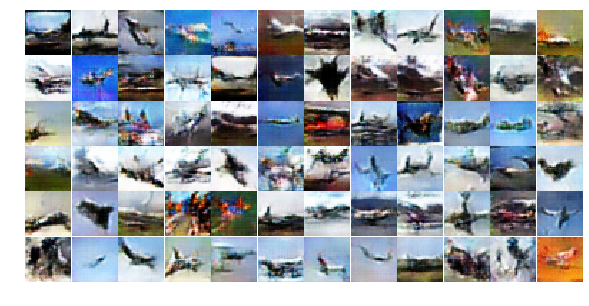


 45%|████▍     | 134/300 [21:52<26:45,  9.67s/it]

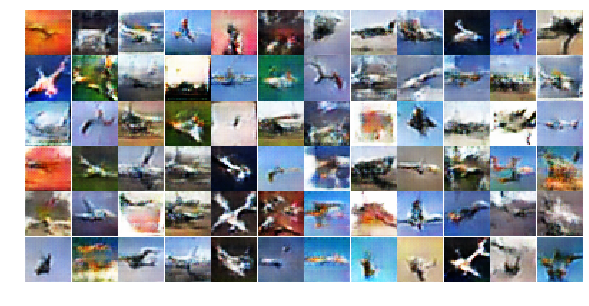


 45%|████▌     | 136/300 [22:12<26:22,  9.65s/it]

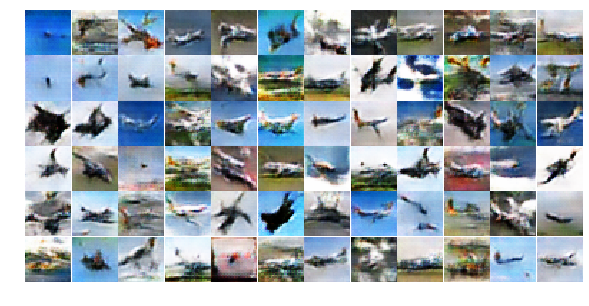


 46%|████▌     | 138/300 [22:32<25:52,  9.58s/it]

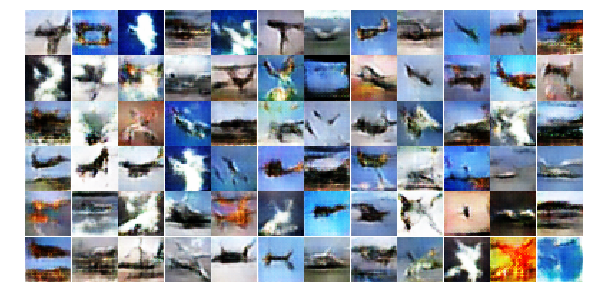


 47%|████▋     | 140/300 [22:52<25:46,  9.66s/it]

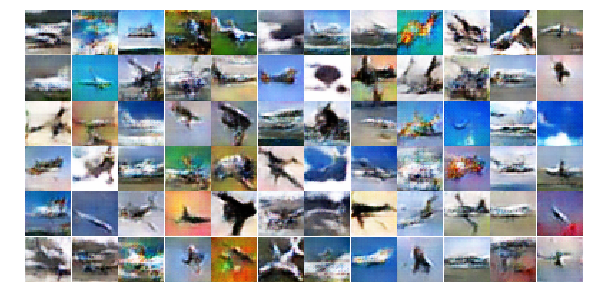


 47%|████▋     | 142/300 [23:13<25:31,  9.69s/it]

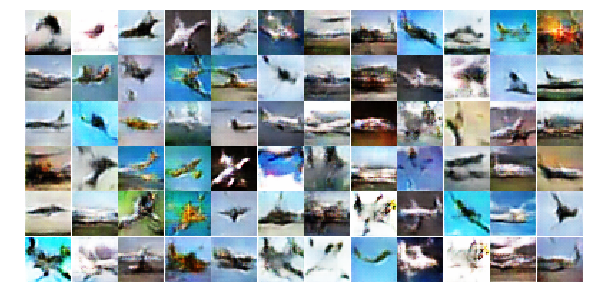


 48%|████▊     | 144/300 [23:32<24:58,  9.61s/it]

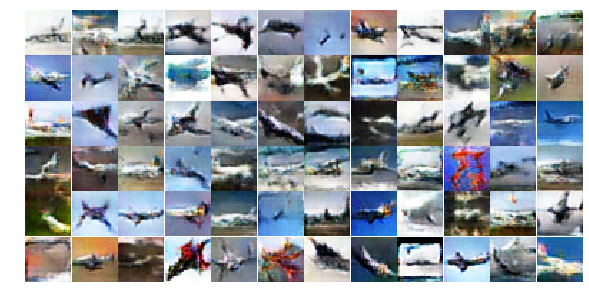


 49%|████▊     | 146/300 [23:53<24:49,  9.67s/it]

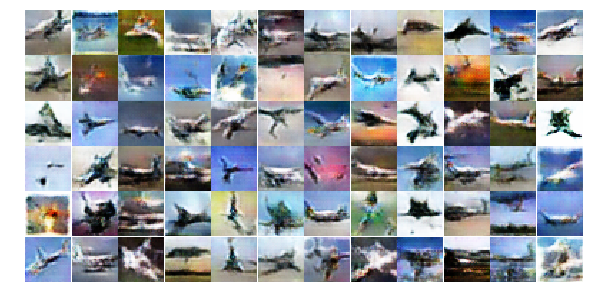


 49%|████▉     | 148/300 [24:13<24:22,  9.62s/it]

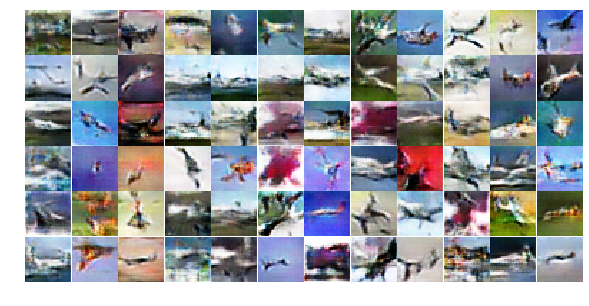


 50%|█████     | 150/300 [24:33<24:17,  9.72s/it]

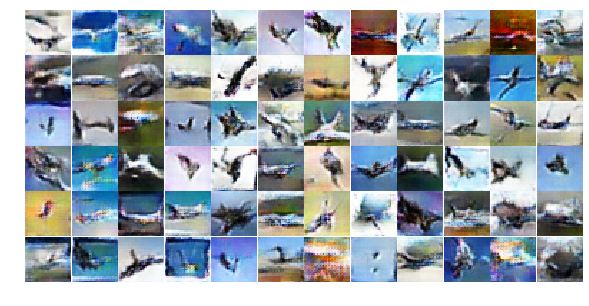


 51%|█████     | 152/300 [24:54<23:59,  9.72s/it]

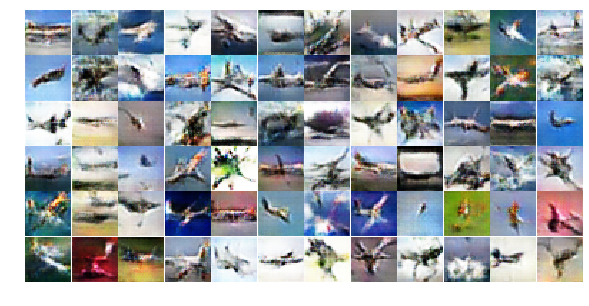


 51%|█████▏    | 154/300 [25:14<23:26,  9.63s/it]

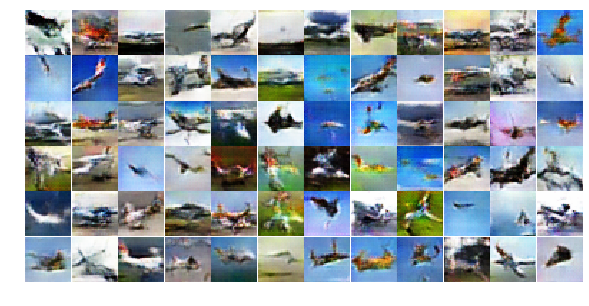


 52%|█████▏    | 156/300 [25:34<23:17,  9.71s/it]

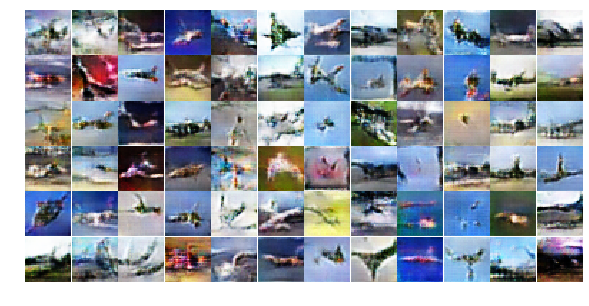


 53%|█████▎    | 158/300 [25:55<22:58,  9.71s/it]

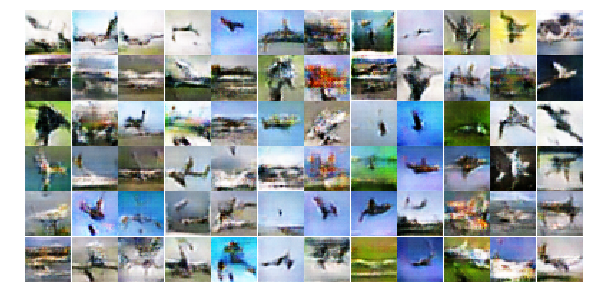


 53%|█████▎    | 160/300 [26:15<22:27,  9.62s/it]

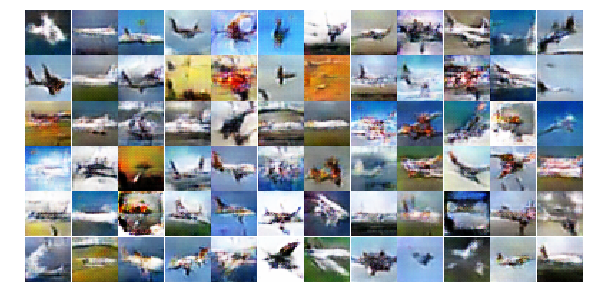


 54%|█████▍    | 162/300 [26:35<22:13,  9.66s/it]

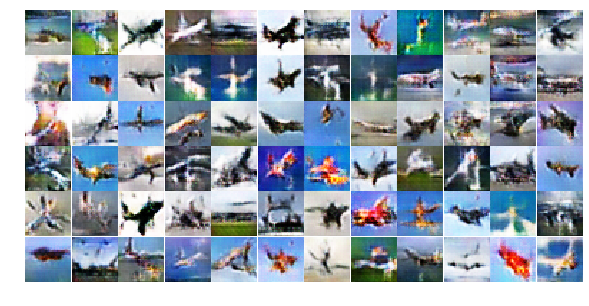


 55%|█████▍    | 164/300 [26:55<21:35,  9.52s/it]

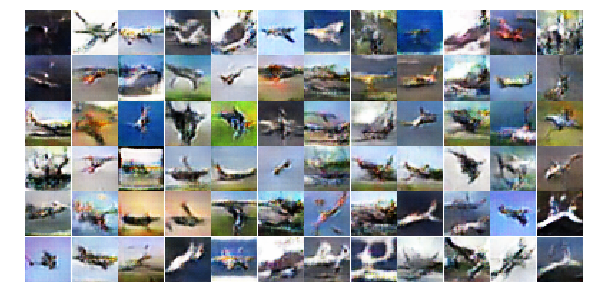


 55%|█████▌    | 166/300 [27:15<21:25,  9.60s/it]

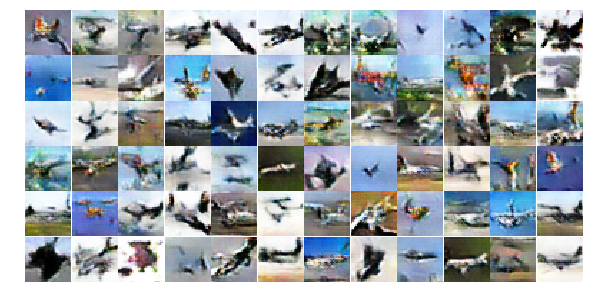


 56%|█████▌    | 168/300 [27:35<20:56,  9.52s/it]

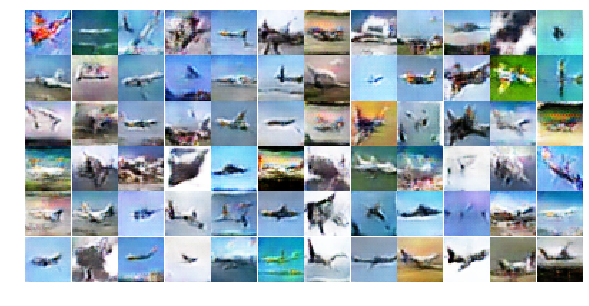


 57%|█████▋    | 170/300 [27:55<20:43,  9.57s/it]

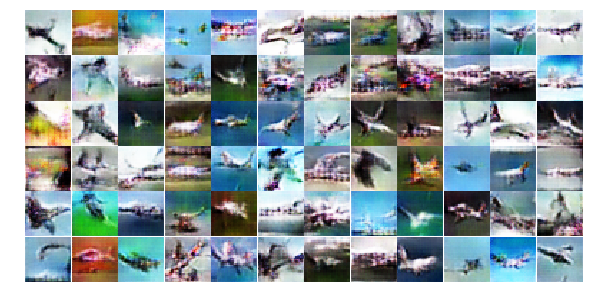


 57%|█████▋    | 172/300 [28:15<20:22,  9.55s/it]

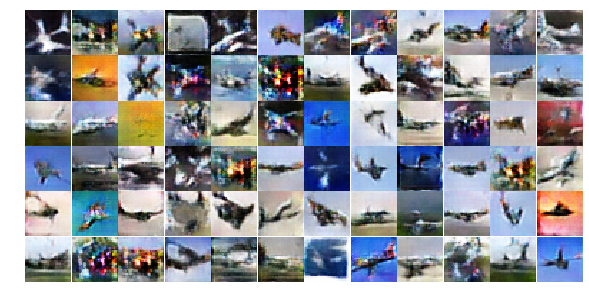


 58%|█████▊    | 174/300 [28:35<19:56,  9.49s/it]

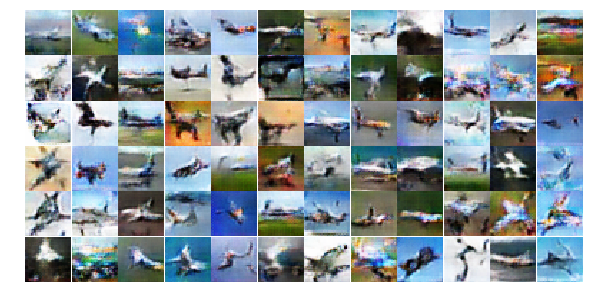


 59%|█████▊    | 176/300 [28:55<19:53,  9.63s/it]

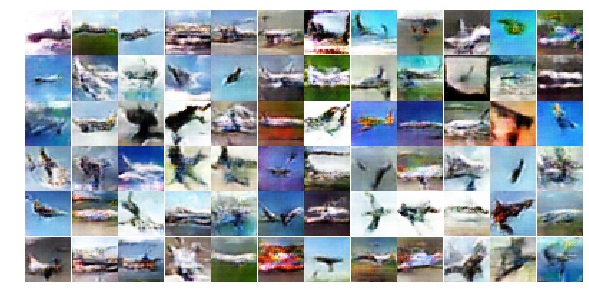


 59%|█████▉    | 178/300 [29:15<19:31,  9.60s/it]

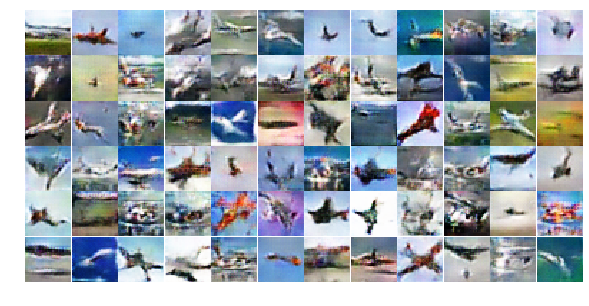


 60%|██████    | 180/300 [29:36<19:25,  9.71s/it]

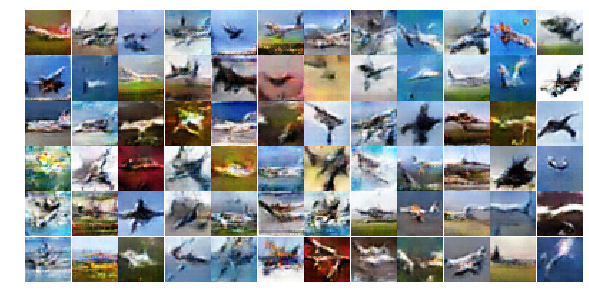


 61%|██████    | 182/300 [29:56<19:07,  9.72s/it]

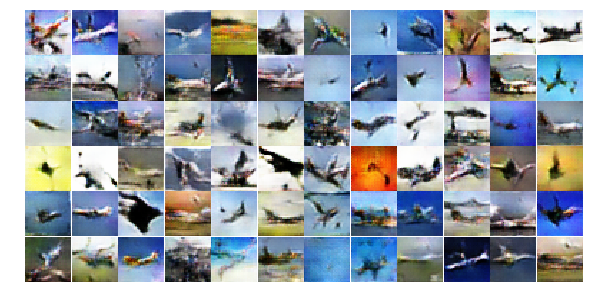


 61%|██████▏   | 184/300 [30:16<18:37,  9.63s/it]

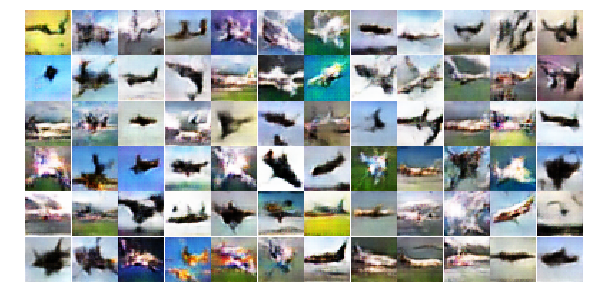


 62%|██████▏   | 186/300 [30:37<18:31,  9.75s/it]

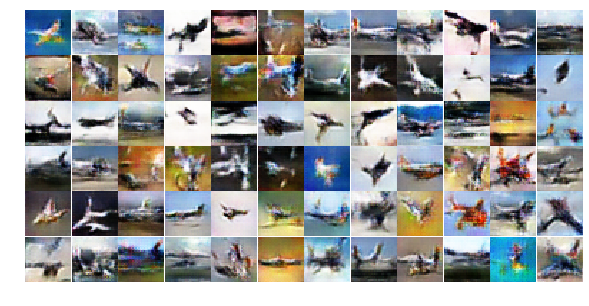


 63%|██████▎   | 188/300 [30:57<18:00,  9.65s/it]

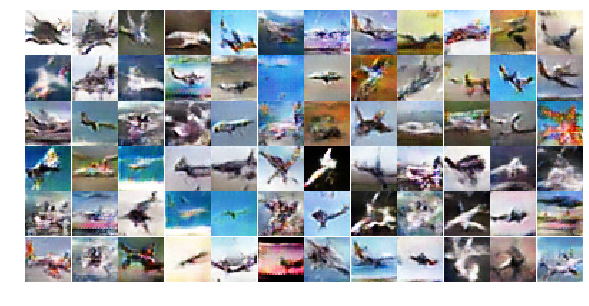


 63%|██████▎   | 190/300 [31:18<17:49,  9.72s/it]

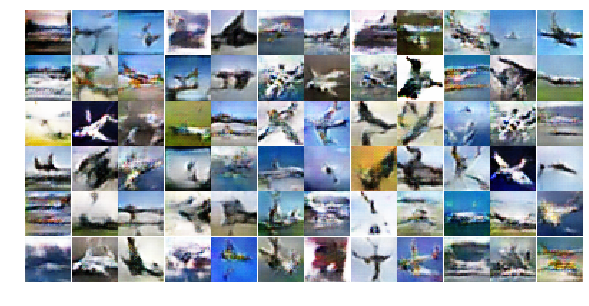


 64%|██████▍   | 192/300 [31:38<17:24,  9.68s/it]

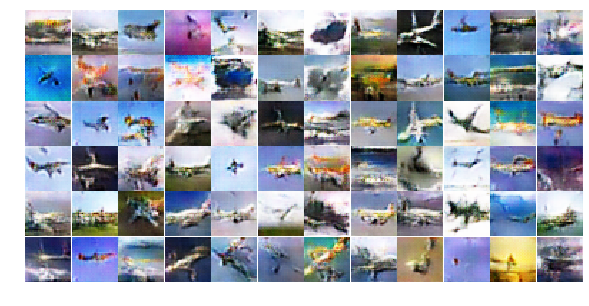


 65%|██████▍   | 194/300 [31:58<17:12,  9.74s/it]

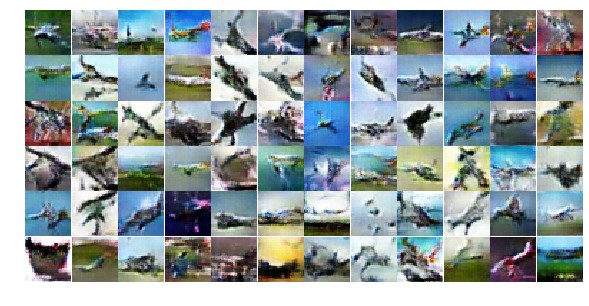


 65%|██████▌   | 196/300 [32:19<16:53,  9.75s/it]

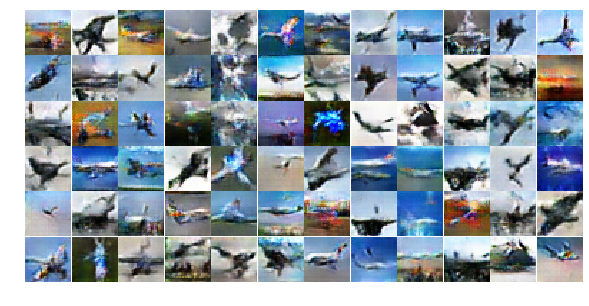


 66%|██████▌   | 198/300 [32:39<16:23,  9.64s/it]

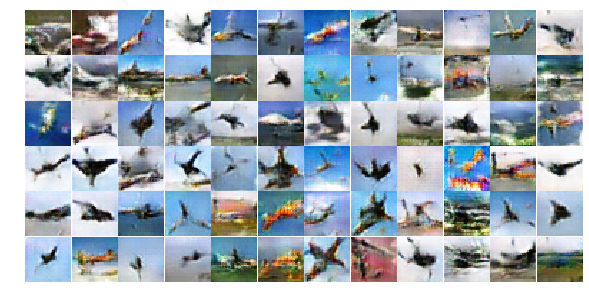


 67%|██████▋   | 200/300 [32:59<16:13,  9.74s/it]

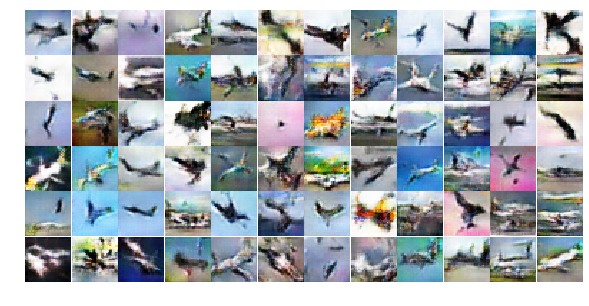


 67%|██████▋   | 202/300 [33:19<15:45,  9.65s/it]

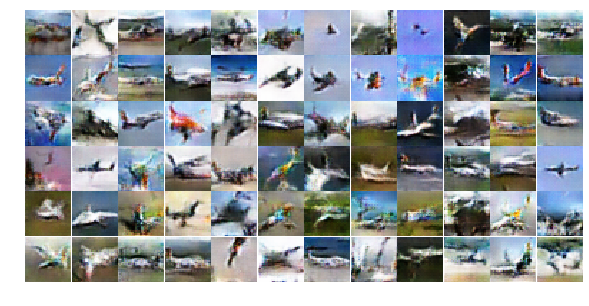


 68%|██████▊   | 204/300 [33:40<15:36,  9.75s/it]

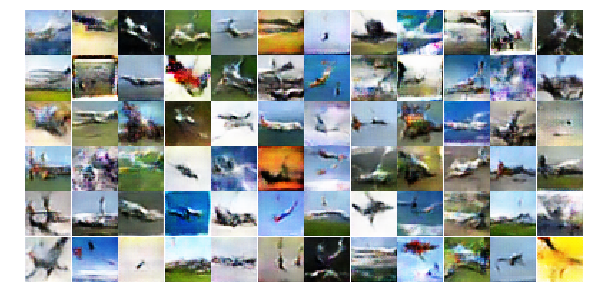


 69%|██████▊   | 206/300 [34:00<15:07,  9.66s/it]

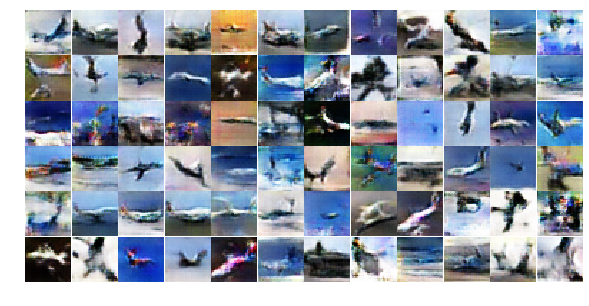


 69%|██████▉   | 208/300 [34:21<14:55,  9.73s/it]

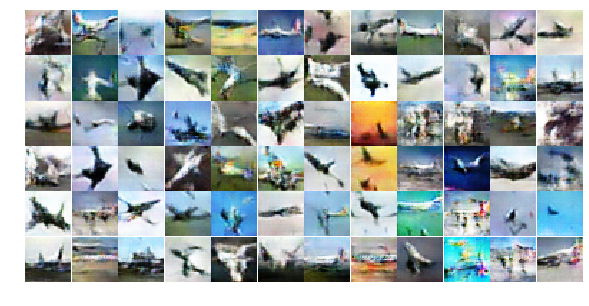


 70%|███████   | 210/300 [34:41<14:31,  9.68s/it]

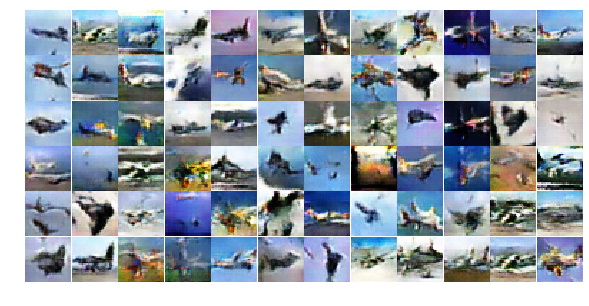


 71%|███████   | 212/300 [35:02<14:18,  9.76s/it]

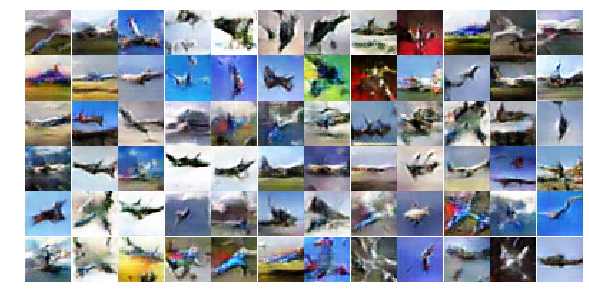


 71%|███████▏  | 214/300 [35:22<13:50,  9.66s/it]

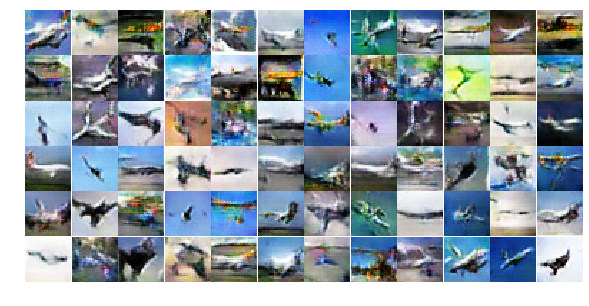


 72%|███████▏  | 216/300 [35:42<13:41,  9.78s/it]

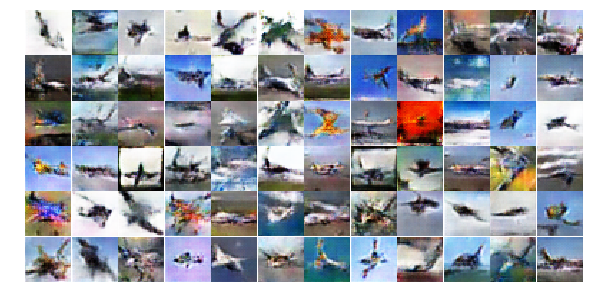


 73%|███████▎  | 218/300 [36:03<13:15,  9.70s/it]

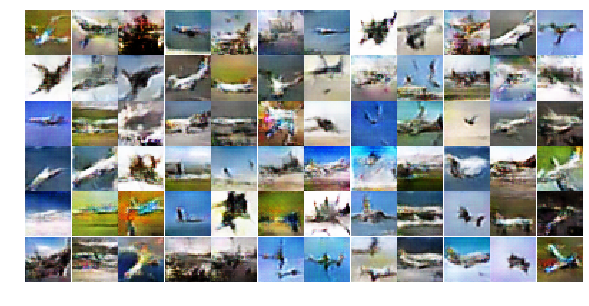


 73%|███████▎  | 220/300 [36:23<13:02,  9.79s/it]

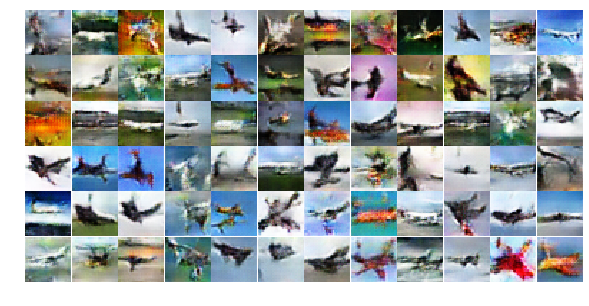


 74%|███████▍  | 222/300 [36:44<12:38,  9.73s/it]

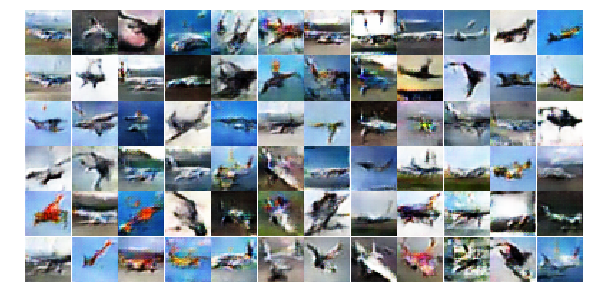


 75%|███████▍  | 224/300 [37:04<12:22,  9.78s/it]

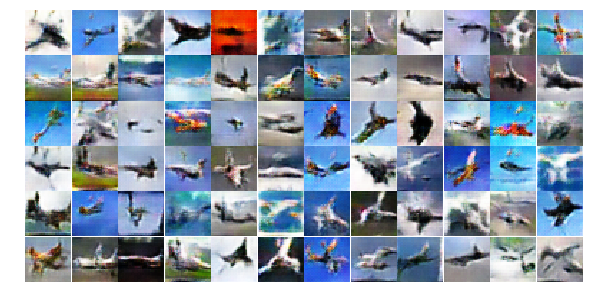


 75%|███████▌  | 226/300 [37:24<11:55,  9.67s/it]

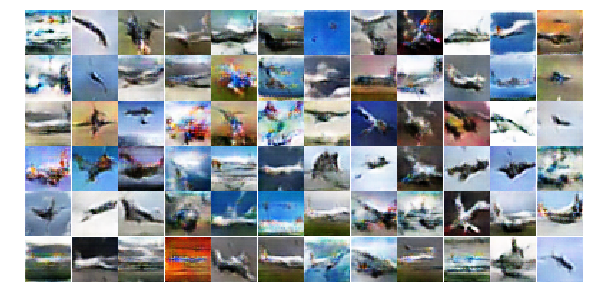


 76%|███████▌  | 228/300 [37:45<11:39,  9.72s/it]

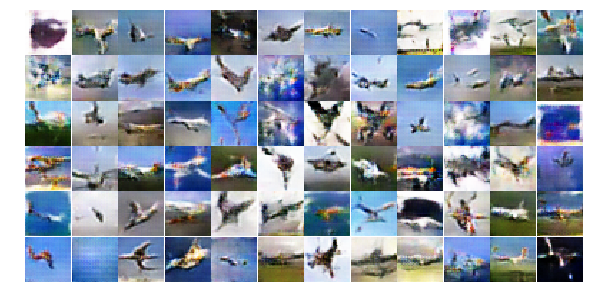


 77%|███████▋  | 230/300 [38:05<11:12,  9.61s/it]

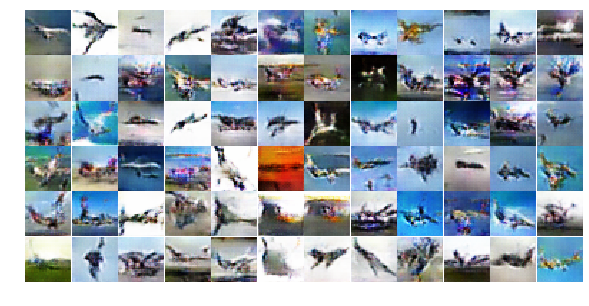


 77%|███████▋  | 232/300 [38:25<10:58,  9.69s/it]

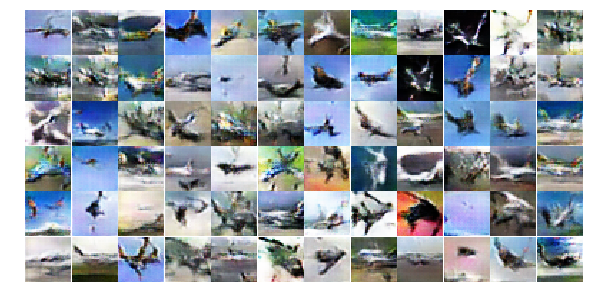


 78%|███████▊  | 234/300 [38:45<10:35,  9.64s/it]

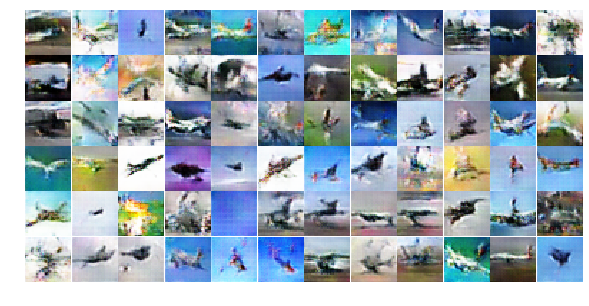


 79%|███████▊  | 236/300 [39:06<10:22,  9.72s/it]

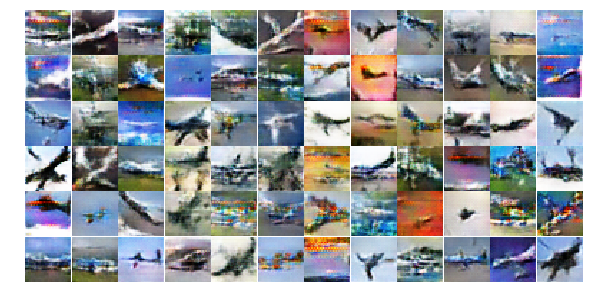


 79%|███████▉  | 238/300 [39:26<09:57,  9.64s/it]

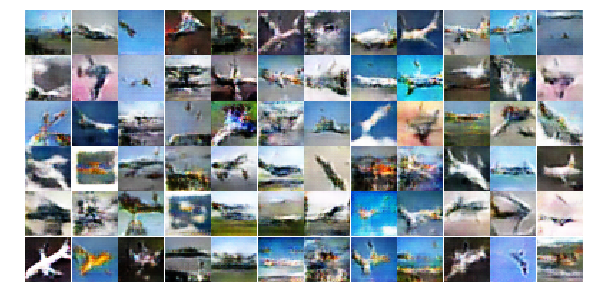


 80%|████████  | 240/300 [39:47<09:48,  9.80s/it]

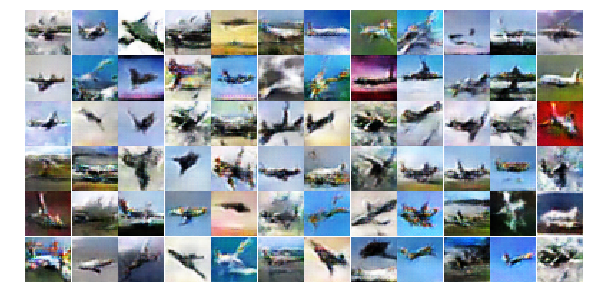


 81%|████████  | 242/300 [40:07<09:23,  9.72s/it]

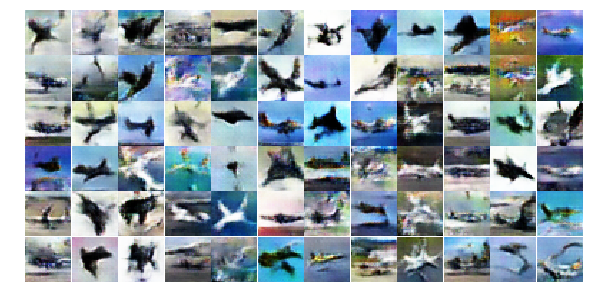


 81%|████████▏ | 244/300 [40:28<09:06,  9.76s/it]

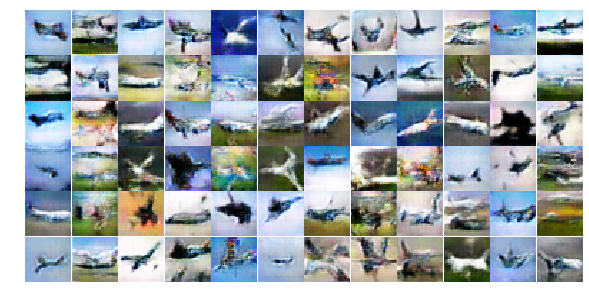


 82%|████████▏ | 246/300 [40:48<08:41,  9.66s/it]

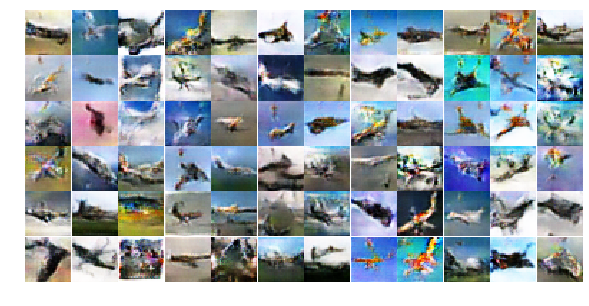


 83%|████████▎ | 248/300 [41:09<08:25,  9.71s/it]

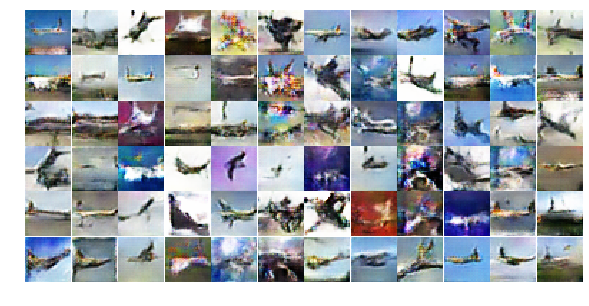


 83%|████████▎ | 250/300 [41:28<08:00,  9.61s/it]

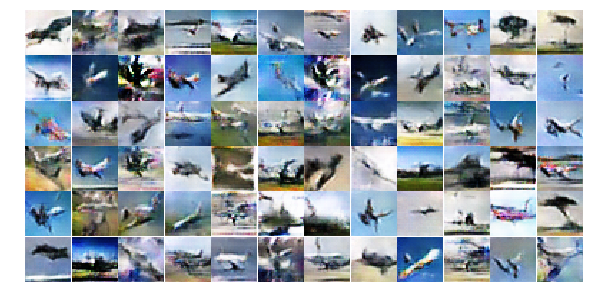


 84%|████████▍ | 252/300 [41:49<07:40,  9.60s/it]

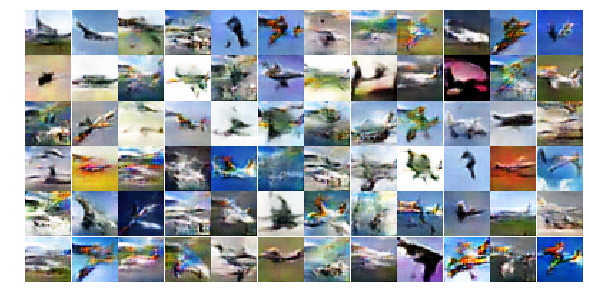


 85%|████████▍ | 254/300 [42:09<07:24,  9.65s/it]

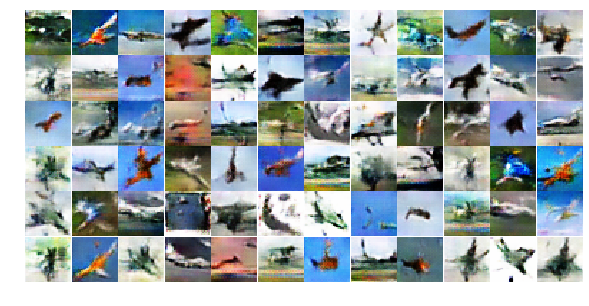


 85%|████████▌ | 256/300 [42:29<06:58,  9.51s/it]

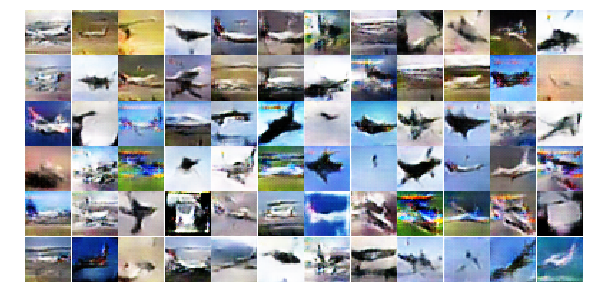


 86%|████████▌ | 258/300 [42:49<06:43,  9.60s/it]

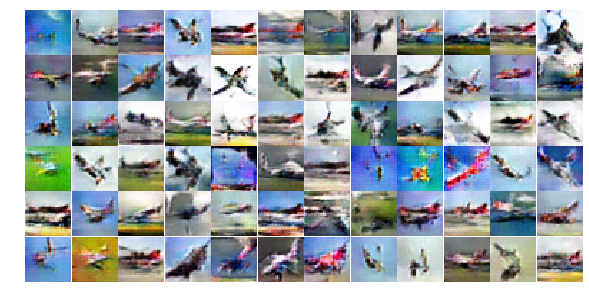


 87%|████████▋ | 260/300 [43:09<06:19,  9.48s/it]

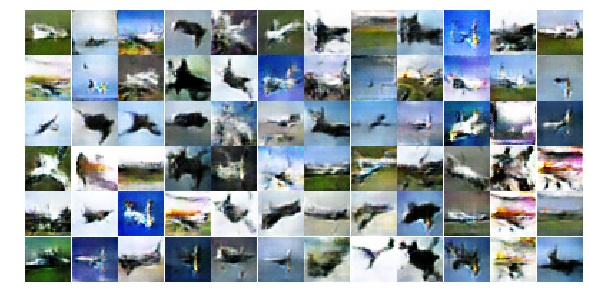


 87%|████████▋ | 262/300 [43:29<06:03,  9.58s/it]

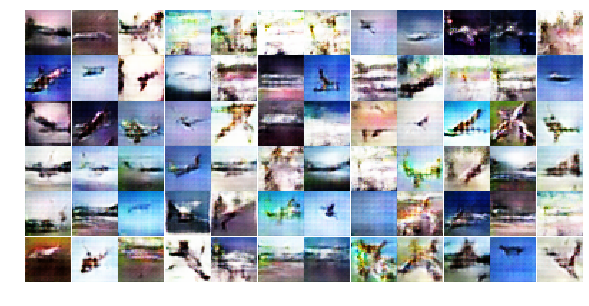


 88%|████████▊ | 264/300 [43:49<05:44,  9.56s/it]

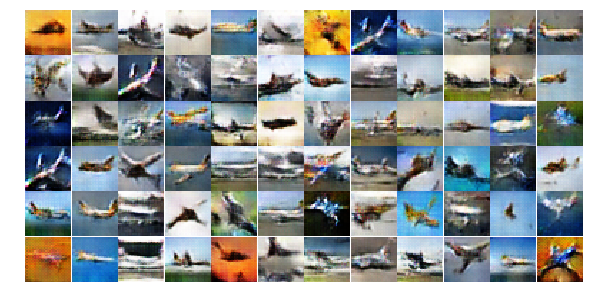


 89%|████████▊ | 266/300 [44:10<05:28,  9.65s/it]

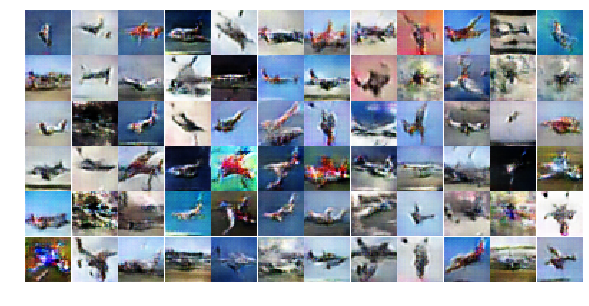


 89%|████████▉ | 268/300 [44:29<05:02,  9.46s/it]

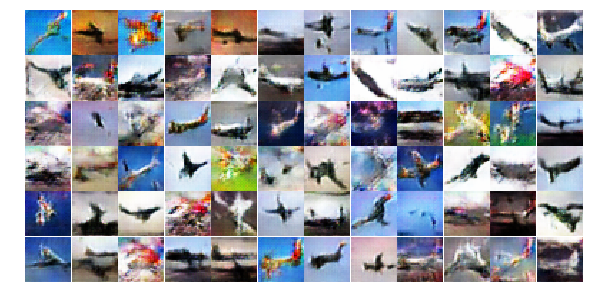


 90%|█████████ | 270/300 [44:49<04:46,  9.56s/it]

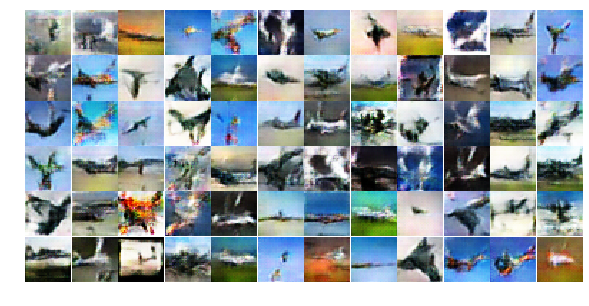


 91%|█████████ | 272/300 [45:09<04:22,  9.38s/it]

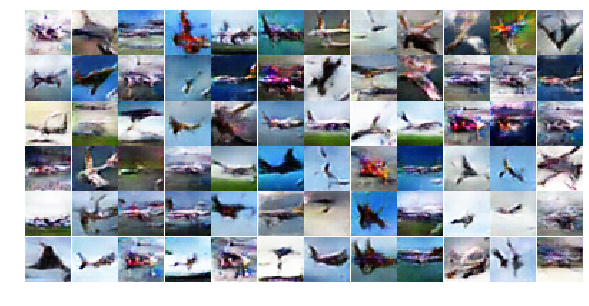


 91%|█████████▏| 274/300 [45:29<04:07,  9.50s/it]

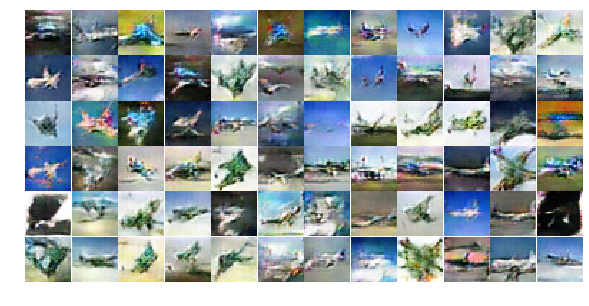


 92%|█████████▏| 276/300 [45:49<03:48,  9.51s/it]

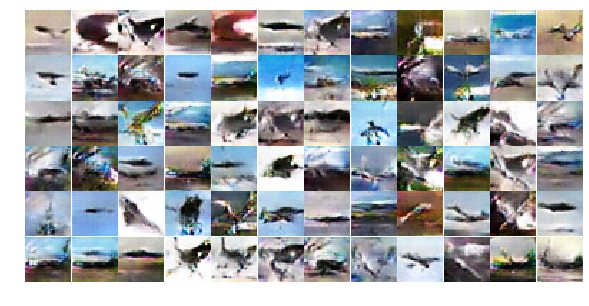


 93%|█████████▎| 278/300 [46:09<03:30,  9.59s/it]

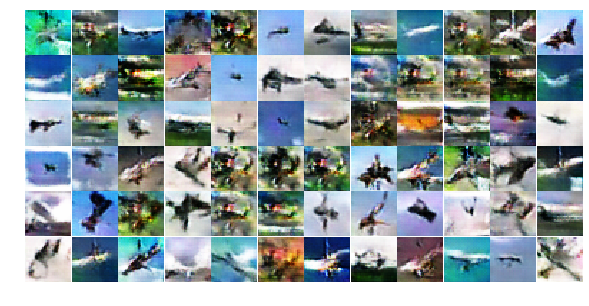


 93%|█████████▎| 280/300 [46:29<03:09,  9.48s/it]

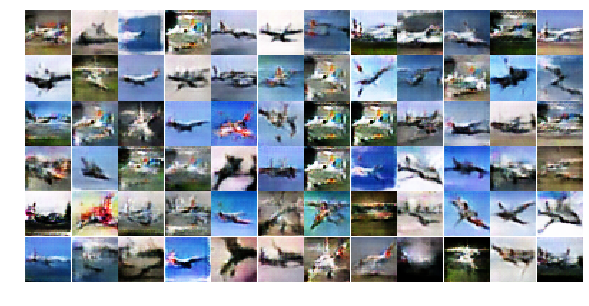


 94%|█████████▍| 282/300 [46:49<02:53,  9.64s/it]

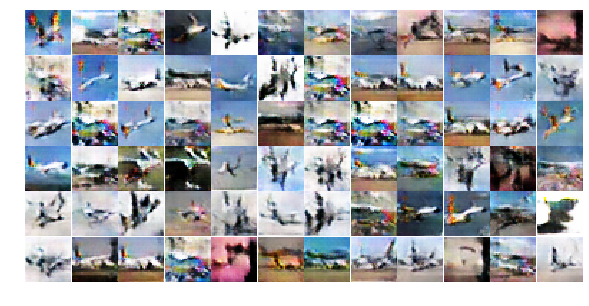


 95%|█████████▍| 284/300 [47:09<02:33,  9.59s/it]

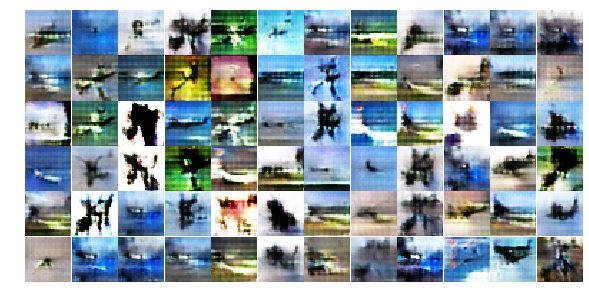


 95%|█████████▌| 286/300 [47:29<02:12,  9.45s/it]

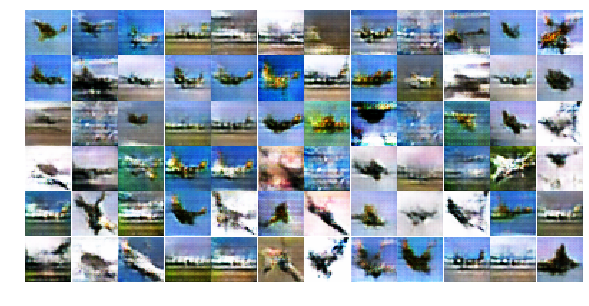


 96%|█████████▌| 288/300 [47:49<01:54,  9.56s/it]

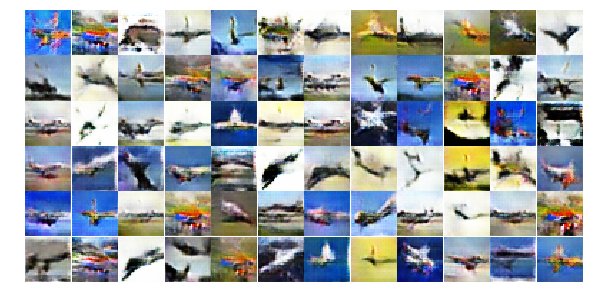


 97%|█████████▋| 290/300 [48:09<01:34,  9.48s/it]

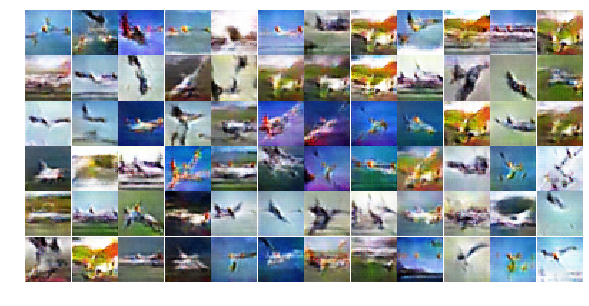


 97%|█████████▋| 292/300 [48:29<01:16,  9.60s/it]

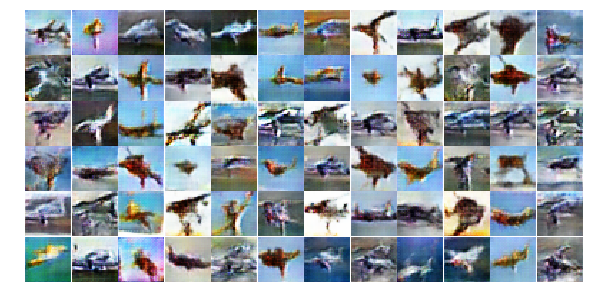


 98%|█████████▊| 294/300 [48:49<00:56,  9.39s/it]

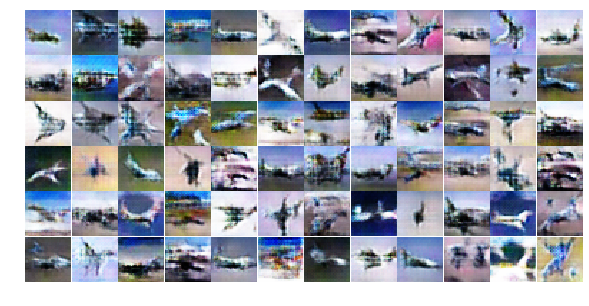


 99%|█████████▊| 296/300 [49:08<00:37,  9.38s/it]

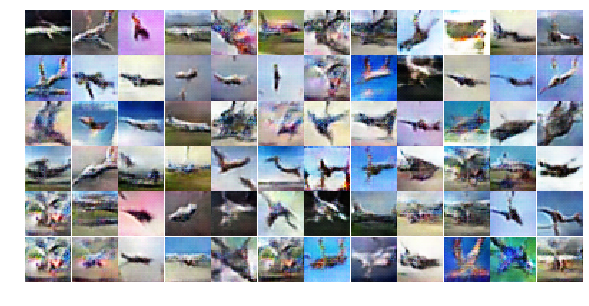


 99%|█████████▉| 298/300 [49:28<00:18,  9.36s/it]

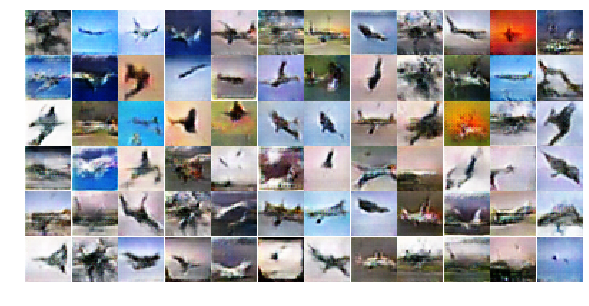


100%|██████████| 300/300 [49:48<00:00,  9.51s/it]


In [0]:
# Training the GAN network through 300 epochs with batch_size 128
gan.train(batch_size=128, epochs=300)